<div class="alert alert-block alert-info">
<div style="text-align: center;"><h1>Antimicrobial Resistance (AMR)<h1>
<h2>A Global Health Crisis Happening Now!<h2></div>

<div style="text-align: center;"><img src="AMR.jpg" width=50%>
<h5>Disc diffusion antibiotic sentivity testing.</h5></div>
Large, clear zones of growth inhibition around each antibiotic disc is indicative of bacterial sensitivity (two discs on right of plate).<br>
Resistance is indicated by bacterial growth up to the disc's edge (remaining three discs).

***
# The rise of AMR
The serendipitous discover of antibiotics by Sir Alexander Flemming in 1928 ushered in the golden age of antibiotics and revolutionised medicine.<br>
Morbidity and mortality from common bacterial infections in the: skin (impetigo); eyes, nose, throat (conjunctivitus, sinusitis, Strep throat, respectively); gastrointestinal tract (diarrhoea); respiratory tract (pneumonia); urogenital tract (bladder infections and sexually transmitted diseases, STDs); from wounds and many more were dramatically reduced and even eliminated.<br>

However, decades of over prescribing and agricultural misuse have led to the development of resistance against our limited arsenal of antibiotics. With no new antibiotics reaching the market, we are faced with the prospect of not being able to effectively treat even these simple infections.<br>

The 2016 O'Neill report<sup>__[1](https://antimicrobialresistancefighters.org/stories/story-lord-jim-o-neill)__</sup> projects global AMR-related deaths to approach 10 million by 2050, with economic losses in the order of US$100 trillion. These are sobering figures.<br>

# Harnessing technological advancements
The human genome project<sup>__[2](https://www.genome.gov/human-genome-project)__</sup>, whose goal was to sequence the entire human DNA, launched in 1990 and took a decade to complete!<br>
However, today sequencing an entire organism takes as little as several hours<sup>__[3](https://med.stanford.edu/news/all-news/2022/01/dna-sequencing-technique.html)__</sup>. This technological leap is a game changer for the fight against AMR.<br>
The advent of AI and machine learning (ML) is a another tool scientists are taking advantage of to combat the rise in AMR in recent years.<br>
Combined, scientists now have the ability to interrogate and identify bacterial DNA sequences (patterns) associated with the development of antimicrobial resistance. Knowing an infection's response to antibiotics translates to faster disease resolution whilst preserving the effectiveness our dwindling frontline antibiotics. 

# Project goals
Although not a silver bullet, this project demonstrates the immense utility of machine learning in predicting antibiotic resistance in the exemplar STD, **gonorrhea**. Given DNA fragments from _Neisseria gonorrhoeae_ (the bacterial etiology of gonorrhea), ensemble ML classifiers (_e.g._, Random Forest, XGBoost) were used to predict the bacterial genetic markers of antibiotic resistance. This is powerful for informing the appropriateness of the antibiotics to be prescribed for disease resolution.

# Datatsets
The datasets have been generously made available by Dr. Nicole Wheeler<sup>__[4](https://www.kaggle.com/nwheeler443)__</sup>.<br>

This classification project to model antibiotic resistance makes use of data from two datasets referred to as 'metadata' and 'unitigs' files.<br>
Antibiotic phenotypes (sensitive/resistant) are contained in the metadata file (labels, y).<br>
Phenotype-associated bacterial genetic elements, unitigs (derived from a genome wide association study (GWAS)), are contained in the unitig files (features, X).<br>
Unitigs having the lowest p-values from a GWAS for sensitivity/resistance to each specific antibiotic  were selected.

# Methodology
Following exploratory data analysis, missing _N. gonorrhoeae_ phenotypes were dropped for each of the antibiotics (azithromycin, ciprofloxacin and cefixime). Additionally, some unitigs found to be concatenataed were separated before analysis.<br>

Three classifiers were modelled with cross validation for their abilities to predict antibiotic resistance, and evaluated on accuracy, recall, precision, AUROC and compute time.<br>
Support Vector Machine (SVM) algorithms are capable of handling non-linear relationships in high-dimensional space as found in genomic data. The ensemble nature of XGBoost and Random Forest resist overfitting and can capture complex genomic patterns.<br>
Critically, each algorithm allows the identification of important features (_i.e._, unitigs) contributing to AMR development.

***
# Main findings
_N. gonorrhoeae_ resistance to azithromycin (12.9%) and ciprofloxacin (46.2%) is worryingly high, with incidences distributed across north America, Europe and Asia. In contrast, cefixime resistance is extremely low at 0.1% and restricted to only a few countries (although this second observation may reflect an artifact of data collection).<br>

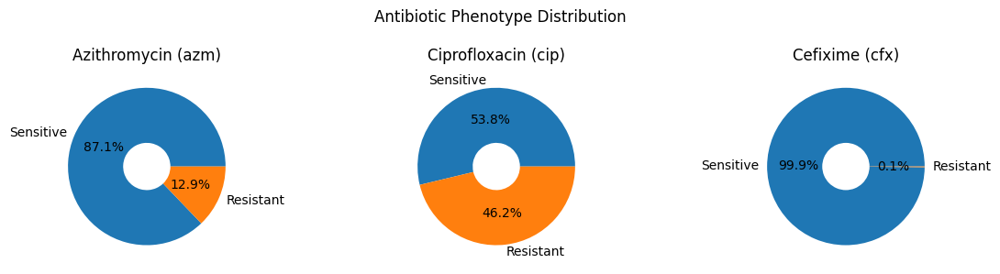<br>

The three antibiotics belong to different classes: azithromycin (macrolide); ciprofloxacin (fluoroquinolone); and cefixime (3G cephalosporin). The difference in their effectiveness hints at their different mechanisms of action in _N. gonorrhoeae_. A common strategy to circumvent resistance is by combination therapy to mitigate bacterial evolutionary pressure.<br>

The classification results for azithromycin are summarised in the figure below.<br>
All models performed well in predicting antibiotic phenotypes with accuracy >90%, particularly SVM(rbf) & XGBoost. The 'Balanced Accuracy' and 'F1' scores can be important for imbalanced classes (<em>e.g.</em>, for azithromycin & cefixime). The F1 score is the 'harmonic' mean of the Recall and Precision scores. Training on larger datasets and hyperparameter tuning may lead to improvement in F1 scores.<br>
There is a ~20x range in computation time, and ~4x diffrence between SVM(rbf) and XGBoost which for this small dataset is negligible.<br>

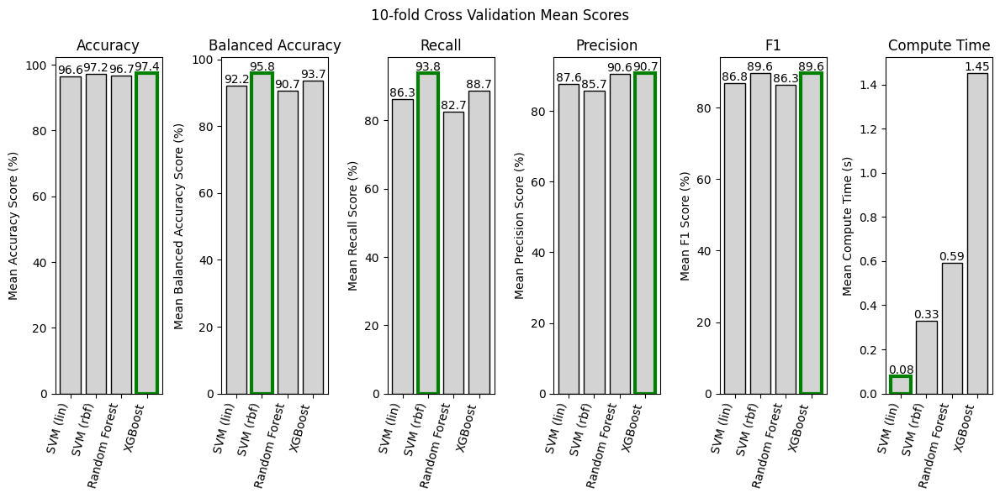<br>

The high AUROC scores further lend confidence to the models' robustness.<br>

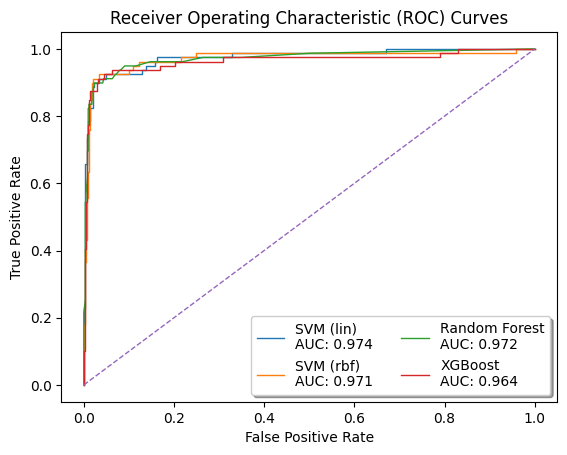<br>

### Perhaps most salient is finding that all three algorithms identified the same two unitigs as important resistance markers of _N. gonorrhoeae_ for azithromycin use!!!<br>
'GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGCGTTGGAAGTTTGACG' and 'TCATCTCGTATGCCGTCTTCTGCTTGAAAAA'.<br>

An NCBI BLAST search was unsuccessful in identifying candidate genes, given their short length.

# Conclusions and future directions
The importance and roles of the identified untigs still need to be experimentally verified. However, the independent convergence of the different models to identify the same markers of resistance is compelling evidence that the predictive power of ML algorithms can relatively easily untangle genomic data to help understand the mechanisms of AMR - this is an encouraging first step!<br>

Further refinement to the models' hyperparameters and training with larger datasets may lead to improved performances (_e.g._, reducing false negatives). Exploiting backpropagation of neural networks could be an interesting approach as would cluster analysis of unitigs.<br>

The application of data science, bioinformatics and AI/ML methods to biomedicine and healthcare are powerful tools to turn the tide against disease and improve patient outcomes. Imagine identifying the bacterium causing an infection by sequencing its genome (in only a few hours!) and knowing which antibiotics are effective to administer at the point of care. This could soon be achievable, but may require another technological breakthrough.

***
***
# Modelling Genomic Factors of Antimicrobial Resistance in *Neisseria gonorrhoeae* to the antibiotics azithromycin (azm), ciprofloxacin (cip) and cefixime (cfx).

### *Neisseria gonorrhoeae* (aka gonococcus) is a gram negative diplococcus and a human pathogen. It is the causitive agent for the sexually transmitted disease (STD), gonorrhea.

In [1]:
from pandas import read_csv, set_option, DataFrame
from geopandas import read_file
from numpy import vectorize, where, argmax, mean, arange, round
from matplotlib.pyplot import subplots, show, subplots_adjust
from seaborn import boxplot
from collections import Counter
from time import process_time

from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC, SVC
from xgboost import XGBClassifier

from sklearn.metrics import f1_score, recall_score, precision_score, balanced_accuracy_score, accuracy_score, roc_curve, roc_auc_score

# Inspect 'metadata' file

In [2]:
# This file contains the antibiotic phenotypes (sensitive/resistant) and other features extraneous to classification.

set_option('display.max_columns', None)  # Force Pandas to show/display all columns of dataframe

metadata_df = read_csv('gono_amr_data/metadata.csv', index_col='Sample_ID')  # Set column index 0/Sample_ID as the df index. This will be handy for matching samples with the GWAS-filtered unitig dataset for each antibiotic (see below)
print(metadata_df.shape)
print(metadata_df.columns)
metadata_df.head()

(3786, 30)
Index(['Year', 'Country', 'Continent', 'Beta.lactamase', 'Azithromycin',
       'Ciprofloxacin', 'Ceftriaxone', 'Cefixime', 'Tetracycline',
       'Penicillin', 'NG_MAST', 'Group', 'azm_mic', 'cip_mic', 'cro_mic',
       'cfx_mic', 'tet_mic', 'pen_mic', 'log2_azm_mic', 'log2_cip_mic',
       'log2_cro_mic', 'log2_cfx_mic', 'log2_tet_mic', 'log2_pen_mic',
       'azm_sr', 'cip_sr', 'cro_sr', 'cfx_sr', 'tet_sr', 'pen_sr'],
      dtype='object')


,Year,Country,Continent,Beta.lactamase,Azithromycin,Ciprofloxacin,Ceftriaxone,Cefixime,Tetracycline,Penicillin,NG_MAST,Group,azm_mic,cip_mic,cro_mic,cfx_mic,tet_mic,pen_mic,log2_azm_mic,log2_cip_mic,log2_cro_mic,log2_cfx_mic,log2_tet_mic,log2_pen_mic,azm_sr,cip_sr,cro_sr,cfx_sr,tet_sr,pen_sr
Sample_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ERR1549286,2015.0,UK,Europe,NaN,>256,NaN,0.016,NaN,NaN,NaN,9768,1058,512.0,NaN,0.016,NaN,NaN,NaN,9.0,NaN,-5.965784,NaN,NaN,NaN,1.0,NaN,0.0,NaN,NaN,NaN
ERR1549290,2015.0,UK,Europe,NaN,>256,NaN,0.004,NaN,NaN,NaN,9768,1058,512.0,NaN,0.004,NaN,NaN,NaN,9.0,NaN,-7.965784,NaN,NaN,NaN,1.0,NaN,0.0,NaN,NaN,NaN
ERR1549291,2015.0,UK,Europe,NaN,>256,NaN,0.006,NaN,NaN,NaN,9768,1058,512.0,NaN,0.006,NaN,NaN,NaN,9.0,NaN,-7.380822,NaN,NaN,NaN,1.0,NaN,0.0,NaN,NaN,NaN
ERR1549287,2015.0,UK,Europe,NaN,>256,NaN,0.006,NaN,NaN,NaN,9768,1058,512.0,NaN,0.006,NaN,NaN,NaN,9.0,NaN,-7.380822,NaN,NaN,NaN,1.0,NaN,0.0,NaN,NaN,NaN
ERR1549288,2015.0,UK,Europe,NaN,>256,NaN,0.008,NaN,NaN,NaN,9768,1058,512.0,NaN,0.008,NaN,NaN,NaN,9.0,NaN,-6.965784,NaN,NaN,NaN,1.0,NaN,0.0,NaN,NaN,NaN


<div class="alert alert-block alert-info">
Summary of 30 features of metadata file:<br>

Year: 1979-2017 (30, non-contiguous)<br>
Country: 65 countries<br>
Continent: 5 continents<br>
Beta.lactamase: ?Classification of beta lactamase type ('0', '1', '2', 'R', 'S')?<br>
Antibiotic Minimum Inhibitory Concentrations (MICs): Azithromycin, Ciprofloxacin, Ceftriaxone, Cefixime, Tetracycline, Penicillin<br>
NG_MAST: *N. gonorrhoeae* Multi-Antigen Sequence Type<br>
Group: Appears related to NG_MAST<br>
MIC values: azm_mic, cip_mic, cro_mic, cfx_mic, tet_mic, pen_mic<br>
Log of MICs: log2_azm_mic, log2_cip_mic, log2_cro_mic, log2_cfx_mic, log2_tet_mic, log2_pen_mic<br>
Antibiotic phenotype (y): azm_sr, cip_sr, cro_sr, cfx_sr, tet_sr, pen_sr (0=Sensitive, 1=Resistant)<br>

Only need antibiotic phenotype from this dataset as the label, y.

In [3]:
metadata_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3786 entries, ERR1549286 to ERR2172354
Data columns (total 30 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Year            3536 non-null   float64
 1   Country         3785 non-null   object 
 2   Continent       3785 non-null   object 
 3   Beta.lactamase  1927 non-null   object 
 4   Azithromycin    3480 non-null   object 
 5   Ciprofloxacin   3129 non-null   object 
 6   Ceftriaxone     3436 non-null   object 
 7   Cefixime        3405 non-null   object 
 8   Tetracycline    1472 non-null   object 
 9   Penicillin      1465 non-null   object 
 10  NG_MAST         3779 non-null   object 
 11  Group           3786 non-null   int64  
 12  azm_mic         3478 non-null   float64
 13  cip_mic         3088 non-null   float64
 14  cro_mic         3434 non-null   float64
 15  cfx_mic         3401 non-null   float64
 16  tet_mic         1472 non-null   float64
 17  pen_mic         1465 no

<div class="alert alert-block alert-info">
Heaps of missing data. Let's take a closer look...

In [4]:
metadata_df.isnull().sum()

Year               250
Country              1
Continent            1
Beta.lactamase    1859
Azithromycin       306
Ciprofloxacin      657
Ceftriaxone        350
Cefixime           381
Tetracycline      2314
Penicillin        2321
NG_MAST              7
Group                0
azm_mic            308
cip_mic            698
cro_mic            352
cfx_mic            385
tet_mic           2314
pen_mic           2321
log2_azm_mic       308
log2_cip_mic       698
log2_cro_mic       352
log2_cfx_mic       385
log2_tet_mic      2314
log2_pen_mic      2321
azm_sr             308
cip_sr             698
cro_sr             352
cfx_sr             385
tet_sr            2314
pen_sr            2321
dtype: int64

<div class="alert alert-block alert-info">
Quite a few missing values from the labels/antibiotic phenotypes (xxx_sr).<br>
Will consider only azithromycin (azm_sr), ciprofloxacin (cip_sr) and cefixime (cfx_sr) since only have unitig files for these three antibiotics.

# Inspect antibiotic phenotype (label) balance

In [5]:
# Understanding the missing data

pheno_acc = ['azm_sr', 'cip_sr', 'cfx_sr']  # acc = azm, cip, cfx

sensitive = []
resistant = []
pheno_counts = []
missing = []
missing_pc = []
available = []
available_pc = []
total = metadata_df.shape[0]
for i in pheno_acc:
    s = metadata_df[i].value_counts()[0]
    r = metadata_df[i].value_counts()[1]
    sr = metadata_df[i].value_counts()
    m = metadata_df[i].isnull().sum()
    m_pc = round(m/total * 100, 1)
    avail = total - m
    a_pc = round(avail/total * 100, 1)
    
    sensitive.append(s)
    resistant.append(r)
    pheno_counts.append(sr)
    missing.append(m)
    missing_pc.append(m_pc)
    available.append(avail)
    available_pc.append(a_pc)

In [6]:
# Display missing data info in dataframe

pheno_df = DataFrame({'Antibiotic': pheno_acc, 'Missing': missing, '% Missing': missing_pc, 'Available': available, '% Available': available_pc, 'Sensitive': sensitive, 'Resistant': resistant,})
pheno_df

,Antibiotic,Missing,% Missing,Available,% Available,Sensitive,Resistant
0,azm_sr,308,8.1,3478,91.9,3031,447
1,cip_sr,698,18.4,3088,81.6,1660,1428
2,cfx_sr,385,10.2,3401,89.8,3396,5


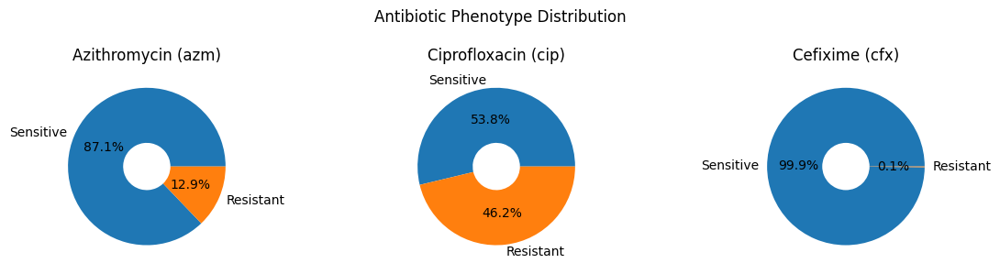

In [7]:
# Antibiotic phenotype distribution

antibiotic_name =['Azithromycin (azm)', 'Ciprofloxacin (cip)', 'Cefixime (cfx)']  # Order must match pheno_acc
pheno_labels = ['Sensitive', 'Resistant']  # [0, 1]
counter = 0
fig, axes = subplots(ncols=len(pheno_acc), figsize=(12,3))

for pc, ax in zip(pheno_counts, axes.ravel()):
    ax.pie(x=pc, labels=pheno_labels, wedgeprops=dict(width=0.7), autopct='%1.1f%%')
    ax.set_title(f'{antibiotic_name[counter]}')
    counter += 1

fig.suptitle('Antibiotic Phenotype Distribution')
fig.tight_layout()

show()

<div class="alert alert-block alert-info">
The ciprofloxacin phenotype is most balanced of the three antibiotics, which means its clinical effectiveness against gonoccocus is highly compromised with close to half of the isolates resistant.<br>
Azithromycin is usually administered in combination with ceftriaxone. Combination therapy is a strategy to mitigate/delay resistance development.<br>
Cefixime is the most imbalanced and, therefore, likely to be the most clinically effect of the three antibiotics.

# Inspect range of Minimum Inhibitory Concentrations (MIC)

In [8]:
metadata_df.describe()

,Year,Group,azm_mic,cip_mic,cro_mic,cfx_mic,tet_mic,pen_mic,log2_azm_mic,log2_cip_mic,log2_cro_mic,log2_cfx_mic,log2_tet_mic,log2_pen_mic,azm_sr,cip_sr,cro_sr,cfx_sr,tet_sr,pen_sr
count,3536.000000,3786.000000,3478.000000,3088.000000,3434.000000,3401.000000,1472.00000,1465.000000,3478.000000,3088.000000,3434.000000,3401.000000,1472.000000,1465.000000,3478.000000,3088.000000,3434.000000,3401.00000,1472.000000,1465.00000
mean,2010.300622,394.334390,17.118781,7.428788,0.029991,0.064405,7.38609,3.044142,-1.107628,-2.043590,-6.203940,-5.164221,0.835492,-0.427788,0.128522,0.462435,0.001165,0.00147,0.554348,0.34744
std,4.670817,326.263267,90.864520,11.266796,0.080375,0.199151,22.10079,15.447995,2.749441,5.444110,1.772691,1.664672,2.337490,2.259337,0.334718,0.498668,0.034115,0.03832,0.497206,0.47632
min,1979.000000,0.000000,0.004000,0.001000,0.000250,0.001000,0.00800,0.002000,-7.965784,-9.965784,-11.965784,-9.965784,-6.965784,-8.965784,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000
25%,2009.000000,134.000000,0.125000,0.004000,0.004000,0.015000,0.50000,0.250000,-3.000000,-7.965784,-7.965784,-6.058894,-1.000000,-2.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000
50%,2012.000000,275.000000,0.380000,0.094000,0.015000,0.016000,2.00000,0.500000,-1.395929,-3.411195,-6.058894,-5.965784,1.000000,-1.000000,0.000000,0.000000,0.000000,0.00000,1.000000,0.00000
75%,2013.000000,618.000000,1.000000,16.000000,0.032000,0.060000,4.00000,2.000000,0.000000,4.000000,-4.965784,-4.058894,2.000000,1.000000,0.000000,1.000000,0.000000,0.00000,1.000000,1.00000
max,2017.000000,1078.000000,1024.000000,64.000000,2.000000,8.000000,256.00000,512.000000,10.000000,6.000000,1.000000,3.000000,8.000000,9.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.00000


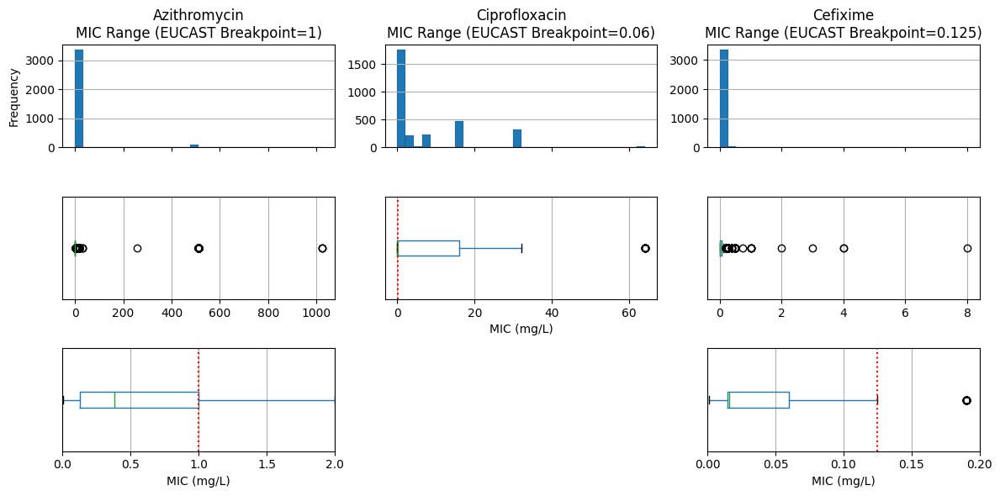

In [9]:
n_rows = 3
n_cols = 3
n_bins = 30
line_width = 0.1
edge_colour = 'k'

fig, ax = subplots(nrows=n_cols, ncols=n_cols, figsize=(12,6))

ax[0,0].hist(metadata_df['azm_mic'], bins=n_bins, linewidth=line_width, edgecolor=edge_colour)
# ax[0,0].axvline(metadata_df['azm_mic'].mean(), linestyle='-.', c='r')
# ax[0,0].axvline(metadata_df['azm_mic'].median(), linestyle='--', c='orange')
ax[0,0].grid(visible=True, axis='y')
ax[0,0].set_xticklabels([])
ax[0,0].set_ylabel('Frequency')
ax[0,0].set_title(f'Azithromycin\nMIC Range (EUCAST Breakpoint=1)')
metadata_df[['azm_mic']].boxplot(vert=False, ax=ax[1,0])
ax[1,0].set_yticks([])
metadata_df[['azm_mic']].boxplot(vert=False, ax=ax[2,0])
ax[2,0].axvline(x=1, linestyle=':', c='r')  # EUCAST breakpoints v. 15.0 valid from 2025-01-01
ax[2,0].set_xlim(0,2)
ax[2,0].set_yticks([])
ax[2,0].set_xlabel('MIC (mg/L)')

ax[0,1].hist(metadata_df['cip_mic'], bins=n_bins, linewidth=line_width, edgecolor=edge_colour)
# ax[0,1].axvline(metadata_df['cip_mic'].mean(), linestyle='-.', c='r')
# ax[0,1].axvline(metadata_df['cip_mic'].median(), linestyle='--', c='orange')
ax[0,1].grid(visible=True, axis='y')
ax[0,1].set_xticklabels([])
# ax[0,1].set_ylabel('Frequency')
ax[0,1].set_title(f'Ciprofloxacin\nMIC Range (EUCAST Breakpoint=0.06)')
metadata_df[['cip_mic']].boxplot(vert=False, ax=ax[1,1])
ax[1,1].set_yticks([])
ax[1,1].axvline(x=0.06, linestyle=':', c='r')  # EUCAST breakpoints v. 15.0 valid from 2025-01-01
ax[1,1].set_xlabel('MIC (mg/L)')
ax[2,1].axis('off')

ax[0,2].hist(metadata_df['cfx_mic'], bins=n_bins, linewidth=line_width, edgecolor=edge_colour)
# ax[0,2].axvline(metadata_df['cfx_mic'].mean(), linestyle='-.', c='r')
# ax[0,2].axvline(metadata_df['cfx_mic'].median(), linestyle='--', c='orange')
ax[0,2].grid(visible=True, axis='y')
ax[0,2].set_xticklabels([])
# ax[0,2].set_ylabel('Frequency')
ax[0,2].set_title(f'Cefixime\nMIC Range (EUCAST Breakpoint=0.125)')
metadata_df[['cfx_mic']].boxplot(vert=False, ax=ax[1,2])
ax[1,2].set_yticks([])
metadata_df[['cfx_mic']].boxplot(vert=False, ax=ax[2,2])
ax[2,2].axvline(x=0.125, linestyle=':', c='r')  # EUCAST breakpoints v. 15.0 valid from 2025-01-01
ax[2,2].set_xlim(0,0.2)
ax[2,2].set_yticks([])
ax[2,2].set_xlabel('MIC (mg/L)')

# subplots_adjust(hspace=0.2)  # Adjust horizontal spacing between subplots

fig.tight_layout()

The bottom row of boxplots have been zoomed in for clarity.<br>
The majority of azithromycin and cefixime MICs are lower than the EUCAST breakpoints<sup>__[5](https://www.eucast.org/clinical_breakpoints)__</sup> (1 mg/L & 0.125 mg/L, respectively) - red dotted lines.<br>
Ciprofloxacin is ineffective against *N. gonorrhoeae* with the majority of isolates exhibiting greater MICs than the EUCAST breakpoint (0.06 mg/L).<br>
$^{5}$ v. 15.0 valid from 2025-01-01.<br>


# Exploration of features extraneous to classification

## Where are the resistant _N. gonorrhoeae_ occuring?

In [10]:
# Import world map

world_map = read_file('/Users/timbo/Coding/NE_World_Map/ne_10m_admin_0_countries.shp')

# Drop Antarctica & Seven seas (open ocean) for a clearer map
world_map = world_map.drop(world_map[world_map['CONTINENT'].isin(['Antarctica', 'Seven seas (open ocean)'])].index)

In [11]:
# Check if countries in 'metadata_df' are spelled the same as in 'world map'

# set_option('display.max_rows', None)

# world_map['NAME'].sort_values()

# Countries where there is recorded azithromycin resistance 

In [12]:
# Countries where there is recorded azithromycin resistance 

resistant_countries_azm = metadata_df['Country'][metadata_df['azm_sr'] == 1].value_counts()
print(len(resistant_countries_azm))
print(resistant_countries_azm)
resistant_countries_azm = metadata_df['Country'][metadata_df['azm_sr'] == 1].sort_values().unique().tolist()


22
Country
Canada             133
USA                123
UK                 107
Denmark             16
Norway              14
Spain                7
Slovenia             7
Ireland              6
Poland               6
Belgium              5
The Netherlands      5
Greece               3
Italy                3
Latvia               2
Austria              2
New_Zealand          2
India                1
China                1
Slovakia             1
Portugal             1
Germany              1
Sweden               1
Name: count, dtype: int64


<div class="alert alert-block alert-info">
North America and UK dominate azithromycin resistant cases.

In [13]:
# Change country name spelling in 'resistant_countries_azm' to match spelling in 'world_map'

resistant_countries_azm[resistant_countries_azm.index('New_Zealand')] = 'New Zealand'
resistant_countries_azm[resistant_countries_azm.index('The Netherlands')] = 'Netherlands'
resistant_countries_azm[resistant_countries_azm.index('UK')] = 'United Kingdom'
resistant_countries_azm[resistant_countries_azm.index('USA')] = 'United States of America'

# Verify changes
print(len(resistant_countries_azm))
print(resistant_countries_azm[resistant_countries_azm.index('New Zealand')])
print(resistant_countries_azm[resistant_countries_azm.index('Netherlands')])
print(resistant_countries_azm[resistant_countries_azm.index('United Kingdom')])
resistant_countries_azm[resistant_countries_azm.index('United States of America')]

22
New Zealand
Netherlands
United Kingdom


'United States of America'

In [14]:
# Countries where azithromycin is effective 

sensitive_countries_azm = metadata_df['Country'][metadata_df['azm_sr'] == 0].sort_values().unique()
print(len(sensitive_countries_azm))
sensitive_countries_azm

65


array(['Angola', 'Argentina', 'Armenia', 'Australia', 'Austria',
       'Belarus', 'Belgium', 'Bhutan', 'Brasil', 'Bulgaria', 'CaboVerde',
       'Canada', 'Caribbean', 'Chile', 'China', 'Cuba', 'Cyprus',
       'Denmark', 'Ecuador', 'Estonia', 'Finland', 'France', 'Gambia',
       'Germany', 'Greece', 'Guinea', 'GuineaBissau', 'HongKong',
       'Hungary', 'Iceland', 'India', 'Indonesia', 'Italy', 'Ivory_Coast',
       'Jamaica', 'Japan', 'Latvia', 'Lithuania', 'Malaysia', 'Malta',
       'Marocko', 'New_Zealand', 'Norway', 'Pakistan', 'Philippines',
       'Poland', 'Portugal', 'Romania', 'Russia', 'Saudi_Arabia',
       'Scotland', 'Slovakia', 'Slovenia', 'South_Africa', 'Spain',
       'Sweden', 'Tanzania', 'Thailand', 'The Netherlands', 'Turkey',
       'UK', 'USA', 'Uganda', 'Vietnam', nan], dtype=object)

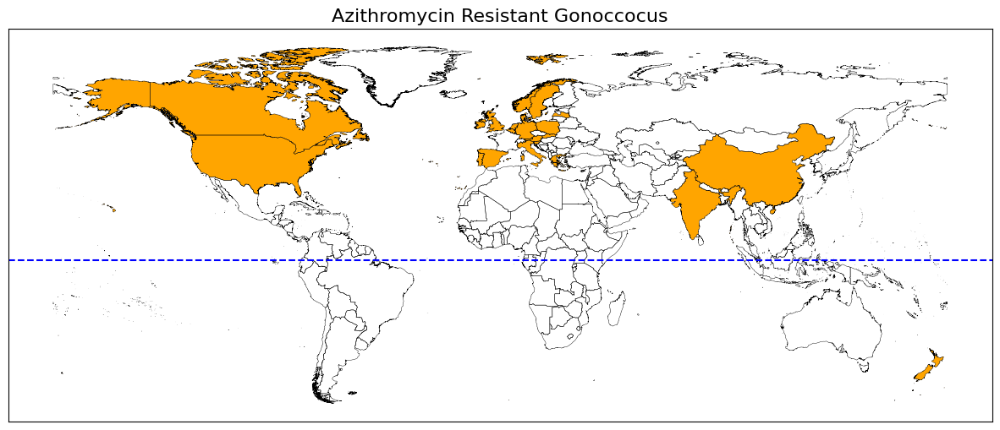

In [15]:
# Plot countries where there is recorded azithromycin resistance 

fig, ax = subplots(figsize=(15,15))

world_map.boundary.plot(linewidth=0.3, edgecolor='k', ax=ax)
ax.axhline(0, linestyle='--', c='b')
ax.set_title('Azithromycin Resistant Gonoccocus', fontsize=16)
ax.set_xticks([])
ax.set_yticks([])
# ax.axis('off')
world_map[world_map['NAME'].isin(resistant_countries_azm)].plot(color='orange', ax=ax)

show()

# Countries where there is recorded ciprofloxacin resistance 

In [16]:
# Countries where there is recorded ciprofloxacin resistance 

resistant_countries_cip = metadata_df['Country'][metadata_df['cip_sr'] == 1].value_counts()
print(len(resistant_countries_cip))
print(resistant_countries_cip)
resistant_countries_cip = metadata_df['Country'][metadata_df['cip_sr'] == 1].sort_values().unique().tolist()

39
Country
USA                597
UK                 156
New_Zealand        123
Canada              99
Spain               70
Portugal            49
Greece              34
Denmark             33
France              31
Belgium             30
Sweden              28
The Netherlands     26
Poland              19
Japan               18
Slovenia            14
India               13
Italy               12
Pakistan             9
Norway               9
Thailand             7
Vietnam              6
China                5
Estonia              5
Australia            4
Malta                4
Belarus              4
Russia               3
Philippines          3
Malaysia             2
Iceland              2
Bhutan               2
Germany              2
GuineaBissau         2
HongKong             2
Slovakia             1
Finland              1
Bulgaria             1
Chile                1
Indonesia            1
Name: count, dtype: int64


<div class="alert alert-block alert-info">
Similiar to azithromycin resistance trend, north America and UK feature high on the list of countries exhibiting cases of ciprofloxacin resistance by gonococcus.

In [17]:
# Change country name spelling in 'resistant_countries_azm' to match spelling in 'world_map'

resistant_countries_cip[resistant_countries_cip.index('GuineaBissau')] = 'Guinea-Bissau'
resistant_countries_cip[resistant_countries_cip.index('HongKong')] = 'Hong Kong'
resistant_countries_cip[resistant_countries_cip.index('New_Zealand')] = 'New Zealand'
resistant_countries_cip[resistant_countries_cip.index('The Netherlands')] = 'Netherlands'
resistant_countries_cip[resistant_countries_cip.index('UK')] = 'United Kingdom'
resistant_countries_cip[resistant_countries_cip.index('USA')] = 'United States of America'

# Verify changes
print(len(resistant_countries_cip))
print(resistant_countries_cip[resistant_countries_cip.index('Guinea-Bissau')])
print(resistant_countries_cip[resistant_countries_cip.index('Hong Kong')])
print(resistant_countries_cip[resistant_countries_cip.index('New Zealand')])
print(resistant_countries_cip[resistant_countries_cip.index('Netherlands')])
print(resistant_countries_cip[resistant_countries_cip.index('United Kingdom')])
resistant_countries_cip[resistant_countries_cip.index('United States of America')]

39
Guinea-Bissau
Hong Kong
New Zealand
Netherlands
United Kingdom


'United States of America'

In [18]:
# Countries where ciprofloxacin is effective

sensitive_countries_cip = metadata_df['Country'][metadata_df['cip_sr'] == 0].sort_values().unique()
print(len(sensitive_countries_cip))
sensitive_countries_cip

56


array(['Angola', 'Argentina', 'Armenia', 'Australia', 'Belarus',
       'Belgium', 'Bhutan', 'Brasil', 'CaboVerde', 'Canada', 'Caribbean',
       'China', 'Cuba', 'Denmark', 'Ecuador', 'Estonia', 'France',
       'Gambia', 'Germany', 'Greece', 'Guinea', 'GuineaBissau', 'Hungary',
       'Iceland', 'India', 'Indonesia', 'Italy', 'Ivory_Coast', 'Jamaica',
       'Japan', 'Lithuania', 'Malta', 'Marocko', 'New_Zealand', 'Norway',
       'Pakistan', 'Philippines', 'Poland', 'Portugal', 'Romania',
       'Russia', 'Saudi_Arabia', 'Scotland', 'Slovakia', 'Slovenia',
       'South_Africa', 'Spain', 'Sweden', 'Tanzania', 'Thailand',
       'The Netherlands', 'Turkey', 'UK', 'USA', 'Uganda', nan],
      dtype=object)

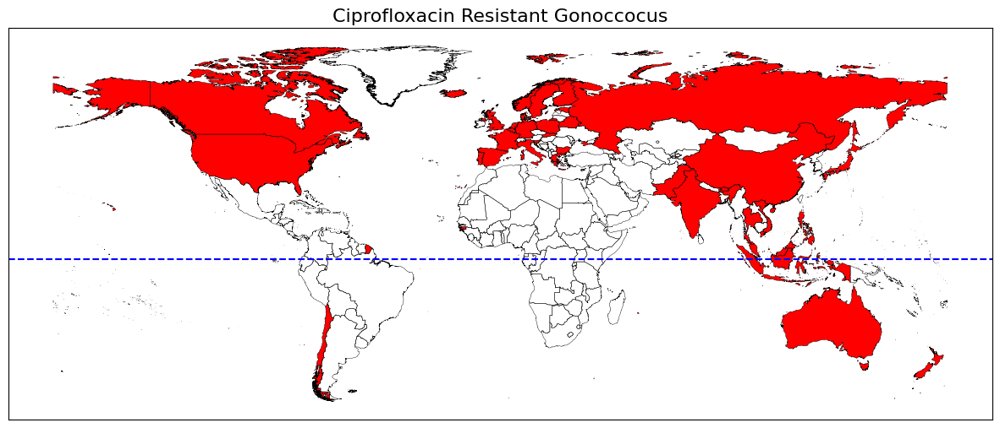

In [19]:
# Plot countries where there is recorded ciprofloxacin resistance 

fig, ax = subplots(figsize=(15,15))

world_map.boundary.plot(linewidth=0.3, edgecolor='k', ax=ax)
ax.axhline(0, linestyle='--', c='b')
ax.set_title('Ciprofloxacin Resistant Gonoccocus', fontsize=16)
ax.set_xticks([])
ax.set_yticks([])
# ax.axis('off')
world_map[world_map['NAME'].isin(resistant_countries_cip)].plot(color='r', ax=ax)

show()

# Countries where there is recorded cefixime resistance 

In [20]:
# Countries where there is recorded cefixime resistance 

resistant_countries_cfx = metadata_df['Country'][metadata_df['cfx_sr'] == 1].value_counts()
print(resistant_countries_cfx)
resistant_countries_cfx = metadata_df['Country'][metadata_df['cfx_sr'] == 1].sort_values().unique().tolist()
print(len(resistant_countries_cfx))
resistant_countries_cfx

Country
France    3
Spain     1
Japan     1
Name: count, dtype: int64
3


['France', 'Japan', 'Spain']

<div class="alert alert-block alert-info">
Interesting that cases of cefixime resistance, in contrast to azithromycin and ciprofloxacin, are fewer and in different countries. 

In [21]:
# Countries where cefixime is effective

sensitive_countries_cfx = metadata_df['Country'][metadata_df['cfx_sr'] == 0].sort_values().unique()
print(len(sensitive_countries_cfx))
sensitive_countries_cfx

66


array(['Angola', 'Argentina', 'Armenia', 'Australia', 'Austria',
       'Belarus', 'Belgium', 'Bhutan', 'Brasil', 'Bulgaria', 'CaboVerde',
       'Canada', 'Caribbean', 'Chile', 'China', 'Cuba', 'Cyprus',
       'Denmark', 'Ecuador', 'Estonia', 'Finland', 'France', 'Gambia',
       'Germany', 'Greece', 'Guinea', 'GuineaBissau', 'HongKong',
       'Hungary', 'Iceland', 'India', 'Indonesia', 'Ireland', 'Italy',
       'Ivory_Coast', 'Jamaica', 'Japan', 'Latvia', 'Lithuania',
       'Malaysia', 'Malta', 'Marocko', 'New_Zealand', 'Norway',
       'Pakistan', 'Philippines', 'Poland', 'Portugal', 'Romania',
       'Russia', 'Saudi_Arabia', 'Scotland', 'Slovakia', 'Slovenia',
       'South_Africa', 'Spain', 'Sweden', 'Tanzania', 'Thailand',
       'The Netherlands', 'Turkey', 'UK', 'USA', 'Uganda', 'Vietnam', nan],
      dtype=object)

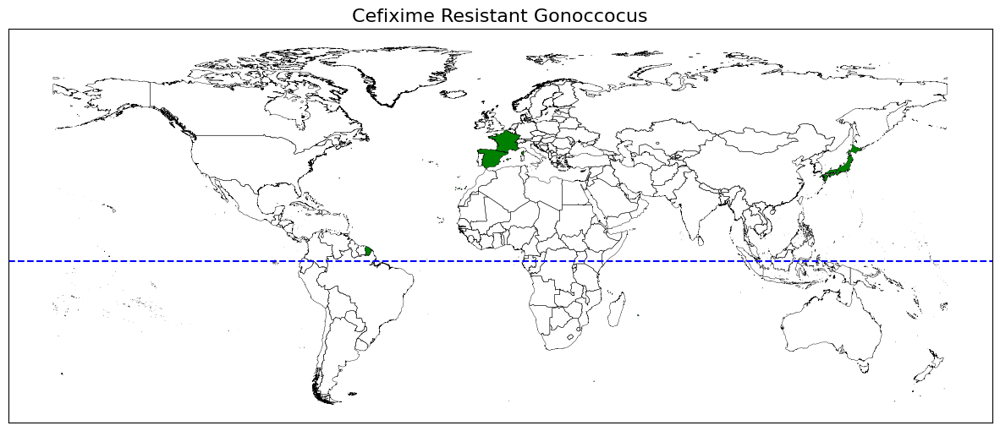

In [22]:
# Plot countries where there is recorded cefixime resistance 

fig, ax = subplots(figsize=(15,15))

world_map.boundary.plot(linewidth=0.3, edgecolor='k', ax=ax)
ax.axhline(0, linestyle='--', c='b')
ax.set_title('Cefixime Resistant Gonoccocus', fontsize=16)
ax.set_xticks([])
ax.set_yticks([])
# ax.axis('off')
world_map[world_map['NAME'].isin(resistant_countries_cfx)].plot(color='g', ax=ax)

show()

In [23]:
# Explore features individually

# print(metadata_df['feature'].nunique())
# metadata_df['feature'].sort_values().unique()

In [24]:
print(metadata_df['Year'].nunique())
metadata_df['Year'].sort_values().unique()

30


array([1979., 1986., 1989., 1990., 1991., 1992., 1993., 1994., 1996.,
       1997., 1998., 1999., 2000., 2001., 2002., 2003., 2004., 2005.,
       2006., 2007., 2008., 2009., 2010., 2011., 2012., 2013., 2014.,
       2015., 2016., 2017.,   nan])

In [25]:
print(metadata_df['Country'].nunique())
metadata_df['Country'].sort_values().unique()

65


array(['Angola', 'Argentina', 'Armenia', 'Australia', 'Austria',
       'Belarus', 'Belgium', 'Bhutan', 'Brasil', 'Bulgaria', 'CaboVerde',
       'Canada', 'Caribbean', 'Chile', 'China', 'Cuba', 'Cyprus',
       'Denmark', 'Ecuador', 'Estonia', 'Finland', 'France', 'Gambia',
       'Germany', 'Greece', 'Guinea', 'GuineaBissau', 'HongKong',
       'Hungary', 'Iceland', 'India', 'Indonesia', 'Ireland', 'Italy',
       'Ivory_Coast', 'Jamaica', 'Japan', 'Latvia', 'Lithuania',
       'Malaysia', 'Malta', 'Marocko', 'New_Zealand', 'Norway',
       'Pakistan', 'Philippines', 'Poland', 'Portugal', 'Romania',
       'Russia', 'Saudi_Arabia', 'Scotland', 'Slovakia', 'Slovenia',
       'South_Africa', 'Spain', 'Sweden', 'Tanzania', 'Thailand',
       'The Netherlands', 'Turkey', 'UK', 'USA', 'Uganda', 'Vietnam', nan],
      dtype=object)

In [26]:
print(metadata_df['Continent'].nunique())
metadata_df['Continent'].sort_values().unique()

5


array(['Africa', 'America', 'Asia', 'Europe', 'Oceania', nan],
      dtype=object)

In [27]:
print(metadata_df['Beta.lactamase'].nunique())
metadata_df['Beta.lactamase'].sort_values().unique()

5


array(['0', '1', '2', 'R', 'S', nan], dtype=object)

In [28]:
# print(metadata_df['Azithromycin']).nunique()
metadata_df['Azithromycin'].sort_values().unique()

array(['0.015', '0.016', '0.023', '0.03', '0.032', '0.047', '0.06',
       '0.063', '0.064', '0.094', '0.12', '0.125', '0.19', '0.25', '0.38',
       '0.5', '0.75', '1', '1.5', '12', '16', '2', '256', '3', '32', '4',
       '6', '8', '<=0.008', '>256', '>=256/>=512', '>=512', '>=64/>=512',
       nan], dtype=object)

In [29]:
print(metadata_df['NG_MAST'].nunique())
# print(metadata_df['NG_MAST'].sort_values().unique())
print(metadata_df['NG_MAST'].value_counts())
metadata_df['NG_MAST'].mode()

956
NG_MAST
-        518
1407     358
2992     159
2400     106
225       87
        ... 
11414      1
8093       1
317        1
9971       1
797        1
Name: count, Length: 956, dtype: int64


0    -
Name: NG_MAST, dtype: object

In [30]:
print(metadata_df['Group'].nunique())
print(metadata_df['Group'].value_counts())
# metadata_df['Group'].sort_values().unique()

957
Group
1       518
127     358
206     159
186     106
179      87
       ... 
756       1
944       1
822       1
1012      1
1051      1
Name: count, Length: 957, dtype: int64


In [31]:
print(metadata_df['azm_mic'].nunique())
metadata_df['azm_mic'].sort_values().unique()

31


array([4.000e-03, 1.500e-02, 1.600e-02, 2.300e-02, 3.000e-02, 3.200e-02,
       4.700e-02, 6.000e-02, 6.300e-02, 6.400e-02, 9.400e-02, 1.200e-01,
       1.250e-01, 1.900e-01, 2.500e-01, 3.800e-01, 5.000e-01, 7.500e-01,
       1.000e+00, 1.500e+00, 2.000e+00, 3.000e+00, 4.000e+00, 6.000e+00,
       8.000e+00, 1.200e+01, 1.600e+01, 3.200e+01, 2.560e+02, 5.120e+02,
       1.024e+03,       nan])

# Define labels, y

In [32]:
# Drop empty rows

metadata_azm_df = metadata_df.copy()  # Work from a copy of the metadata file
metadata_cip_df = metadata_df.copy()
metadata_cfx_df = metadata_df.copy()
print(metadata_df.shape)

metadata_azm_df.dropna(subset=['azm_sr'], inplace=True)  # Drop rows with missing values for azithromycin phenotype
metadata_cip_df.dropna(subset=['cip_sr'], inplace=True)  # Drop rows with missing values for ciprofloxacin phenotype
metadata_cfx_df.dropna(subset=['cfx_sr'], inplace=True)  # Drop rows with missing values for cefixime phenotype

# Verify dropping rows with missing values
print(metadata_azm_df.shape)
print(metadata_cip_df.shape)
metadata_cfx_df.shape

(3786, 30)
(3478, 30)
(3088, 30)


(3401, 30)

In [33]:
# Define labels, y, for each antibiotic

y_azm = metadata_azm_df['azm_sr']
y_cip = metadata_cip_df['cip_sr']
y_cfx = metadata_cfx_df['cfx_sr']

print(y_azm.shape)
print(y_cip.shape)
y_cfx.shape

(3478,)
(3088,)


(3401,)

# Inspect unitig datasets

In [34]:
# Azithromycin GWAS Unitigs

unitigs_azm_df = read_csv('gono_amr_data/unitigs_azm.csv', index_col='pattern_id', low_memory=False)  # Set column index 0/pattern_id as the df index. After transposing, this will harmonise/match with the metadata file labels, y
print(unitigs_azm_df.shape)
unitigs_azm_df

(515, 3971)


ERR1549286  ERR1549290  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC,CACCTT...           1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1           1   

                                                    ERR1549291  ERR1549287  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC,CACCTT...           1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1           1   

                                                    ERR1549288  ERR1549299  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC,CACCTT...           1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1           1   

                                                    ERR1549292  ERR1549298  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC,CACCTT...           1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1         

<div class="alert alert-block alert-info">
The dataset needs transposing.<br>
Strangely, some of the rows are not single unitigs but multiple comma-separated unitigs! This doesn't seem right.<br>
Upon further investigation, all three unitig files have such anomalous unitig entries.<br>
Will keep only first unitig of multiple comma-separated unitigs (<em>i.e.</em>, remove all sequences after first comma).

# Cleaned unitig datasets

In [35]:
# Cleaned azithromycin GWAS unitigs

unitigs_azm_cleaned_df = read_csv('gono_amr_data/unitigs_azm_cleaned.csv', index_col='pattern_id', low_memory=False)  # Set column index 0/pattern_id as the df index. After transposing, this will harmonise/match with the metadata file labels, y
print(unitigs_azm_cleaned_df.shape)
unitigs_azm_cleaned_df

(515, 3971)


ERR1549286  ERR1549290  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC                     1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1           1   

                                                    ERR1549291  ERR1549287  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC                     1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1           1   

                                                    ERR1549288  ERR1549299  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC                     1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1           1   

                                                    ERR1549292  ERR1549298  \
pattern_id                                                                   
CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG              0           0   
TACCGTAACCGGCAATGCGGATATTACGGTC                              0           0   
CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG                             0           0   
AACGGGTTTTCAGACGGCATTCGATATCGGGACG                           0           0   
CCAAAAATTACCCGCGTTGACGTAGCTAAAGA                             0           0   
...                                                        ...         ...   
ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG                        1           1   
ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGCT...           1           1   
ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC                     1           1   
AGCCTGATTCACCAATGGTTTGTTCATAACAA                             1           1   
TTTTGAGCAGAAAGCAGTCAAAAACAGGGGGATTTTGCCCTTTTGAC...           1         

In [36]:
# Cleaned ciprofloxacin GWAS unitigs

unitigs_cip_cleaned_df = read_csv('gono_amr_data/unitigs_cip_cleaned.csv', index_col='pattern_id', low_memory=False)  # Set column index 0/pattern_id as the df index. After transposing, this will harmonise/match with the metadata file
print(unitigs_cip_cleaned_df.shape)
unitigs_cip_cleaned_df

(8873, 3971)


ERR1549286  ERR1549290  \
pattern_id                                                                   
ACGTTTATGCCGTTATCGATCCGATAGCCGGT                             0           0   
CATCTGCACCCTGTCGGCACTCGCCGCCTGAACCACCCCGTCCGGAC...           0           0   
CACAAAACTCGTTTCCTGCTCCGAAATGGGCGA                            0           0   
AAATCTTCCGCTTTAATCCATTTGCCGTCCGA                             0           0   
AAACCTGCCGCAGCCGGCGCATCTTTGGGCGGCGGTCTGGAC                   0           0   
...                                                        ...         ...   
AAGCAGCGCACGCTGTGAATCACATCTTTCGCC                            1           1   
ACCGCGCCGGACAGGGTGCGCGTAAACGGCAGTTG                          1           1   
AACGACAATACACACACCCTTCCCCCGCGCC                              1           1   
AAATTCATCAAAGAGCAAAGCGATTGGAAACCTCTGCCTGCTAATGC...           1           1   
GCCGCCTTGTCCTGATTTTTGTTAATCCGCCA                             1           1   

                                                    ERR1549291  ERR1549287  \
pattern_id                                                                   
ACGTTTATGCCGTTATCGATCCGATAGCCGGT                             0           0   
CATCTGCACCCTGTCGGCACTCGCCGCCTGAACCACCCCGTCCGGAC...           0           0   
CACAAAACTCGTTTCCTGCTCCGAAATGGGCGA                            0           0   
AAATCTTCCGCTTTAATCCATTTGCCGTCCGA                             0           0   
AAACCTGCCGCAGCCGGCGCATCTTTGGGCGGCGGTCTGGAC                   0           0   
...                                                        ...         ...   
AAGCAGCGCACGCTGTGAATCACATCTTTCGCC                            1           1   
ACCGCGCCGGACAGGGTGCGCGTAAACGGCAGTTG                          1           1   
AACGACAATACACACACCCTTCCCCCGCGCC                              1           1   
AAATTCATCAAAGAGCAAAGCGATTGGAAACCTCTGCCTGCTAATGC...           1           1   
GCCGCCTTGTCCTGATTTTTGTTAATCCGCCA                             1           1   

                                                    ERR1549288  ERR1549299  \
pattern_id                                                                   
ACGTTTATGCCGTTATCGATCCGATAGCCGGT                             0           0   
CATCTGCACCCTGTCGGCACTCGCCGCCTGAACCACCCCGTCCGGAC...           0           0   
CACAAAACTCGTTTCCTGCTCCGAAATGGGCGA                            0           0   
AAATCTTCCGCTTTAATCCATTTGCCGTCCGA                             0           0   
AAACCTGCCGCAGCCGGCGCATCTTTGGGCGGCGGTCTGGAC                   0           0   
...                                                        ...         ...   
AAGCAGCGCACGCTGTGAATCACATCTTTCGCC                            1           1   
ACCGCGCCGGACAGGGTGCGCGTAAACGGCAGTTG                          1           1   
AACGACAATACACACACCCTTCCCCCGCGCC                              1           1   
AAATTCATCAAAGAGCAAAGCGATTGGAAACCTCTGCCTGCTAATGC...           1           1   
GCCGCCTTGTCCTGATTTTTGTTAATCCGCCA                             1           1   

                                                    ERR1549292  ERR1549298  \
pattern_id                                                                   
ACGTTTATGCCGTTATCGATCCGATAGCCGGT                             0           0   
CATCTGCACCCTGTCGGCACTCGCCGCCTGAACCACCCCGTCCGGAC...           0           0   
CACAAAACTCGTTTCCTGCTCCGAAATGGGCGA                            0           0   
AAATCTTCCGCTTTAATCCATTTGCCGTCCGA                             0           0   
AAACCTGCCGCAGCCGGCGCATCTTTGGGCGGCGGTCTGGAC                   0           0   
...                                                        ...         ...   
AAGCAGCGCACGCTGTGAATCACATCTTTCGCC                            1           1   
ACCGCGCCGGACAGGGTGCGCGTAAACGGCAGTTG                          1           1   
AACGACAATACACACACCCTTCCCCCGCGCC                              1           1   
AAATTCATCAAAGAGCAAAGCGATTGGAAACCTCTGCCTGCTAATGC...           1           1   
GCCGCCTTGTCCTGATTTTTGTTAATCCGCCA                             1         

In [37]:
# Cleaned cefixime GWAS unitigs

unitigs_cfx_cleaned_df = read_csv('gono_amr_data/unitigs_cfx_cleaned.csv', index_col='pattern_id', low_memory=False)  # Set column index 0/pattern_id as the df index. After transposing, this will harmonise/match with the metadata file
print(unitigs_cfx_cleaned_df.shape)
unitigs_cfx_cleaned_df

(384, 3971)


ERR1549286  ERR1549290  \
pattern_id                                                                   
ACCGGTCAGGGCGACGGGTTTGCGCCCTTTGAT                            0           0   
TGATACGGCGTGTAGGCGGTGTACCAGCCCGGG                            0           0   
CCGCACGGGGGAAATCCTCGCCTTGGCCAATACGCCCGCCTACGATC...           0           0   
GATATAACTGCGTCCGTCGGCATATTCGCCC                              0           0   
ACCCCGCAACACCTCCTGCTCAACCGCAACGACCTCTTGGTCGGCGG              0           0   
...                                                        ...         ...   
GTCGATGTTTTGAGGAACAAACTCGAACAGAAA                            1           1   
ACCGCCATCAGTTTTCCGCTCATCGGAGGAAGGG                           1           1   
TCCCAACAGACCCGGCCGGGCAGACAGCGAACAG                           1           1   
GGAACGCCTGTCCGAGCTTGTCGATGTGCCGGT                            1           1   
CAGCGCATCGGTCATTGTCGGACTCGAGCCGCTGCTGATG                     1           1   

                                                    ERR1549291  ERR1549287  \
pattern_id                                                                   
ACCGGTCAGGGCGACGGGTTTGCGCCCTTTGAT                            0           0   
TGATACGGCGTGTAGGCGGTGTACCAGCCCGGG                            0           0   
CCGCACGGGGGAAATCCTCGCCTTGGCCAATACGCCCGCCTACGATC...           0           0   
GATATAACTGCGTCCGTCGGCATATTCGCCC                              0           0   
ACCCCGCAACACCTCCTGCTCAACCGCAACGACCTCTTGGTCGGCGG              0           0   
...                                                        ...         ...   
GTCGATGTTTTGAGGAACAAACTCGAACAGAAA                            1           1   
ACCGCCATCAGTTTTCCGCTCATCGGAGGAAGGG                           1           1   
TCCCAACAGACCCGGCCGGGCAGACAGCGAACAG                           1           1   
GGAACGCCTGTCCGAGCTTGTCGATGTGCCGGT                            1           1   
CAGCGCATCGGTCATTGTCGGACTCGAGCCGCTGCTGATG                     1           1   

                                                    ERR1549288  ERR1549299  \
pattern_id                                                                   
ACCGGTCAGGGCGACGGGTTTGCGCCCTTTGAT                            0           0   
TGATACGGCGTGTAGGCGGTGTACCAGCCCGGG                            0           0   
CCGCACGGGGGAAATCCTCGCCTTGGCCAATACGCCCGCCTACGATC...           0           0   
GATATAACTGCGTCCGTCGGCATATTCGCCC                              0           0   
ACCCCGCAACACCTCCTGCTCAACCGCAACGACCTCTTGGTCGGCGG              0           0   
...                                                        ...         ...   
GTCGATGTTTTGAGGAACAAACTCGAACAGAAA                            1           1   
ACCGCCATCAGTTTTCCGCTCATCGGAGGAAGGG                           1           1   
TCCCAACAGACCCGGCCGGGCAGACAGCGAACAG                           1           1   
GGAACGCCTGTCCGAGCTTGTCGATGTGCCGGT                            1           1   
CAGCGCATCGGTCATTGTCGGACTCGAGCCGCTGCTGATG                     1           1   

                                                    ERR1549292  ERR1549298  \
pattern_id                                                                   
ACCGGTCAGGGCGACGGGTTTGCGCCCTTTGAT                            0           0   
TGATACGGCGTGTAGGCGGTGTACCAGCCCGGG                            0           0   
CCGCACGGGGGAAATCCTCGCCTTGGCCAATACGCCCGCCTACGATC...           0           0   
GATATAACTGCGTCCGTCGGCATATTCGCCC                              0           0   
ACCCCGCAACACCTCCTGCTCAACCGCAACGACCTCTTGGTCGGCGG              0           0   
...                                                        ...         ...   
GTCGATGTTTTGAGGAACAAACTCGAACAGAAA                            1           1   
ACCGCCATCAGTTTTCCGCTCATCGGAGGAAGGG                           1           1   
TCCCAACAGACCCGGCCGGGCAGACAGCGAACAG                           1           1   
GGAACGCCTGTCCGAGCTTGTCGATGTGCCGGT                            1           1   
CAGCGCATCGGTCATTGTCGGACTCGAGCCGCTGCTGATG                     1         

<div class="alert alert-block alert-info">
The anomalous multiple comma-separated unitigs appear corrected.<br>
There are 8,873 ciprofloxacin-associated unitigs, 515 azithromycin-associated unitigs and 384 cefixime-associated unitigs.

# Define Xs

In [38]:
# Transpose azithromycin unitig dataset and drop rows to match the phenotype (y) rows 

X_azm_df = unitigs_azm_cleaned_df.T  # Transpose the dataframe (rows <-> columns; such that rows=N. gonorrhoeae samples & features=unitigs)
print(X_azm_df.shape)

X_azm_df = X_azm_df[X_azm_df.index.isin(y_azm.index)] # Retain rows that match the phenotype (y) having sensitive/resistance readings
print(X_azm_df.shape)
print(X_azm_df)

X_azm = X_azm_df.to_numpy()
X_azm.shape

(3971, 515)
(3478, 515)
pattern_id  CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG  \
ERR1549286                                                0   
ERR1549290                                                0   
ERR1549291                                                0   
ERR1549287                                                0   
ERR1549288                                                0   
...                                                     ...   
ERR2172350                                                0   
ERR2172351                                                0   
ERR2172352                                                1   
ERR2172353                                                0   
ERR2172354                                                0   

pattern_id  TACCGTAACCGGCAATGCGGATATTACGGTC  CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG  \
ERR1549286                                0                                 0   
ERR1549290                                0              

(3478, 515)

In [39]:
# Transpose cefixime unitig dataset

X_cfx_df = unitigs_cfx_cleaned_df.T  # Transpose the dataframe (rows <-> columns; such that rows=N. gonorrhoeae samples & features=unitigs)
print(X_cfx_df.shape)

X_cfx_df = X_cfx_df[X_cfx_df.index.isin(y_cfx.index)] # Retain rows that match the phenotype (y) having sensitive/resistance readings
print(X_cfx_df.shape)
print(X_cfx_df)

X_cfx = X_cfx_df.to_numpy()
X_cfx.shape

(3971, 384)
(3401, 384)
pattern_id  ACCGGTCAGGGCGACGGGTTTGCGCCCTTTGAT  \
SRR1661154                                  0   
SRR1661156                                  0   
SRR1661157                                  0   
SRR1661158                                  0   
SRR1661159                                  0   
...                                       ...   
SRR5827366                                  0   
SRR5827371                                  0   
SRR5827372                                  0   
SRR5827369                                  0   
SRR5827370                                  0   

pattern_id  TGATACGGCGTGTAGGCGGTGTACCAGCCCGGG  \
SRR1661154                                  0   
SRR1661156                                  0   
SRR1661157                                  0   
SRR1661158                                  0   
SRR1661159                                  0   
...                                       ...   
SRR5827366                                  

(3401, 384)

In [40]:
# Transpose ciprofloxacin unitig dataset

X_cip_df = unitigs_cip_cleaned_df.T  # Transpose the dataframe (rows <-> columns; such that rows=N. gonorrhoeae samples & features=unitigs)
print(X_cip_df.shape)

X_cip_df = X_cip_df[X_cip_df.index.isin(y_cip.index)] # Retain rows that match the phenotype (y) having sensitive/resistance readings
print(X_cip_df.shape)
print(X_cip_df)

X_cip = X_cip_df.to_numpy()
X_cip.shape

(3971, 8873)
(3088, 8873)
pattern_id  ACGTTTATGCCGTTATCGATCCGATAGCCGGT  \
SRR1661154                                 0   
SRR1661156                                 0   
SRR1661157                                 0   
SRR1661158                                 0   
SRR1661159                                 0   
...                                      ...   
SRR5827366                                 0   
SRR5827371                                 0   
SRR5827372                                 0   
SRR5827369                                 0   
SRR5827370                                 0   

pattern_id  CATCTGCACCCTGTCGGCACTCGCCGCCTGAACCACCCCGTCCGGACAAGG  \
SRR1661154                                                  0     
SRR1661156                                                  0     
SRR1661157                                                  0     
SRR1661158                                                  0     
SRR1661159                                                  0 

(3088, 8873)

In [41]:
# Get the unitigs associated with each antibiotic

unitigs_azm = X_azm_df.columns
unitigs_cip = X_cip_df.columns
unitigs_cfx = X_cfx_df.columns

In [42]:
# Get lengths of the unitigs. Vectorize applies the function len() to objects (unitigs) and returns their values

unitigs_azm_lengths = vectorize(len)(unitigs_azm)
unitigs_cip_lengths = vectorize(len)(unitigs_cip)
unitigs_cfx_lengths = vectorize(len)(unitigs_cfx)

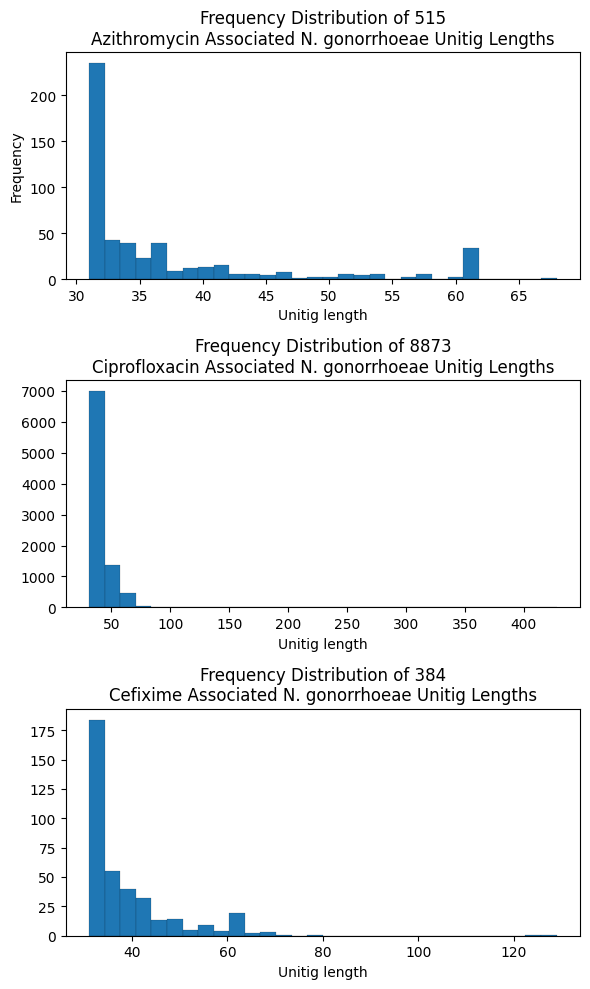

In [43]:
# Inspect unitig lengths

n_rows = 3
n_cols = 1
line_width = 0.1
edge_colour = 'k'
n_bins = 30

fig, ax = subplots(nrows=n_rows, ncols=n_cols, figsize=(6,10))

ax[0].hist(unitigs_azm_lengths, bins=n_bins, linewidth=line_width, edgecolor=edge_colour)
ax[0].set_xlabel('Unitig length')
ax[0].set_ylabel('Frequency')
ax[0].set_title(f"Frequency Distribution of {X_azm.shape[1]}\nAzithromycin Associated N. gonorrhoeae Unitig Lengths")

ax[1].hist(unitigs_cip_lengths, bins=n_bins, linewidth=line_width, edgecolor=edge_colour)
ax[1].set_xlabel('Unitig length')
ax[1].set_title(f"Frequency Distribution of {X_cip.shape[1]}\nCiprofloxacin Associated N. gonorrhoeae Unitig Lengths")

ax[2].hist(unitigs_cfx_lengths, bins=n_bins, linewidth=line_width, edgecolor=edge_colour)
ax[2].set_xlabel('Unitig length')
ax[2].set_title(f"Frequency Distribution of {X_cfx.shape[1]}\nCefixime Associated N. gonorrhoeae Unitig Lengths")

fig.tight_layout()

<div class="alert alert-block alert-info">
The range of azithromycin unitig lengths is smallest (31-68). This is greater for cefixime (31-129).<br>
A few unitigs associated with ciprofloxacin are longer than expected, even after cleaning (31-428).<br>
The majority of unitigs are on the short end of the range.

In [44]:
# Investigate the longer than expected unitigs for ciprofloxacin

print(max(unitigs_cip_lengths))  # Length of longest unitig
print(argmax(unitigs_cip_lengths))  # Numpy index of longest unitig
# print(where(unitigs_cip_lengths > 400))  # Numpy index of unitigs > 400
unitigs_cip_cleaned_df.iloc[845:851, :]  # Peek at longest unitig sequence in dataframe

428
849


ERR1549286  ERR1549290  \
pattern_id                                                                   
TCAGACGGCAACACTCGGCGAAATGCAGTCTGAAGGC                        0           0   
TACAATCGCCGCCCCGTGGTTCGAAAACCTCCCACACTAAAAAA                 0           0   
CCGCAGAGTTTTAAGACGTTCGGCACGGCGG                              0           0   
TAAAATAGGAAATATCCAATGCCAAAGCAATTTGTCGGA                      0           0   
TAGTGAAATTTGCCAAGAAGCACAAAATCAACGATTCCGAGCTGCTG...           0           0   
GTGGAAAAACGCCCCAAAGCGGCAAGTCGGAGGGCG                         0           0   

                                                    ERR1549291  ERR1549287  \
pattern_id                                                                   
TCAGACGGCAACACTCGGCGAAATGCAGTCTGAAGGC                        0           0   
TACAATCGCCGCCCCGTGGTTCGAAAACCTCCCACACTAAAAAA                 0           0   
CCGCAGAGTTTTAAGACGTTCGGCACGGCGG                              0           0   
TAAAATAGGAAATATCCAATGCCAAAGCAATTTGTCGGA                      0           0   
TAGTGAAATTTGCCAAGAAGCACAAAATCAACGATTCCGAGCTGCTG...           0           0   
GTGGAAAAACGCCCCAAAGCGGCAAGTCGGAGGGCG                         0           0   

                                                    ERR1549288  ERR1549299  \
pattern_id                                                                   
TCAGACGGCAACACTCGGCGAAATGCAGTCTGAAGGC                        0           0   
TACAATCGCCGCCCCGTGGTTCGAAAACCTCCCACACTAAAAAA                 0           0   
CCGCAGAGTTTTAAGACGTTCGGCACGGCGG                              0           0   
TAAAATAGGAAATATCCAATGCCAAAGCAATTTGTCGGA                      0           0   
TAGTGAAATTTGCCAAGAAGCACAAAATCAACGATTCCGAGCTGCTG...           0           0   
GTGGAAAAACGCCCCAAAGCGGCAAGTCGGAGGGCG                         0           0   

                                                    ERR1549292  ERR1549298  \
pattern_id                                                                   
TCAGACGGCAACACTCGGCGAAATGCAGTCTGAAGGC                        0           0   
TACAATCGCCGCCCCGTGGTTCGAAAACCTCCCACACTAAAAAA                 0           0   
CCGCAGAGTTTTAAGACGTTCGGCACGGCGG                              0           0   
TAAAATAGGAAATATCCAATGCCAAAGCAATTTGTCGGA                      0           0   
TAGTGAAATTTGCCAAGAAGCACAAAATCAACGATTCCGAGCTGCTG...           0           0   
GTGGAAAAACGCCCCAAAGCGGCAAGTCGGAGGGCG                         0           0   

                                                    ERR1549296  ERR1549300  \
pattern_id                                                                   
TCAGACGGCAACACTCGGCGAAATGCAGTCTGAAGGC                        0           0   
TACAATCGCCGCCCCGTGGTTCGAAAACCTCCCACACTAAAAAA                 0           0   
CCGCAGAGTTTTAAGACGTTCGGCACGGCGG                              0           0   
TAAAATAGGAAATATCCAATGCCAAAGCAATTTGTCGGA                      0           0   
TAGTGAAATTTGCCAAGAAGCACAAAATCAACGATTCCGAGCTGCTG...           0           0   
GTGGAAAAACGCCCCAAAGCGGCAAGTCGGAGGGCG                         0           0   

                                                    ERR1549295  ERR1549294  \
pattern_id                                                                   
TCAGACGGCAACACTCGGCGAAATGCAGTCTGAAGGC                        0           0   
TACAATCGCCGCCCCGTGGTTCGAAAACCTCCCACACTAAAAAA                 0           0   
CCGCAGAGTTTTAAGACGTTCGGCACGGCGG                              0           0   
TAAAATAGGAAATATCCAATGCCAAAGCAATTTGTCGGA                      0           0   
TAGTGAAATTTGCCAAGAAGCACAAAATCAACGATTCCGAGCTGCTG...           0           0   
GTGGAAAAACGCCCCAAAGCGGCAAGTCGGAGGGCG                         0           0   

                                                    ERR1549289  ERR1549293  \
pattern_id                                                                   
TCAGACGGCAACACTCGGCGAAATGCAGTCTGAAGGC                        0           0   
TACAATCGCCGCCCCGTGGTTCGAAAACCTCCCACACTAAAAAA                 0      

<div class="alert alert-block alert-info">
Verified that the longest unitig for ciprofloxacin, 428 bases (and for other two antibiotics - working not shown) is not a result of the previous artifact (<em>i.e.</em>, comma-separated untigs).

# Unitig A,T,G,C composition

In [45]:
# Instantiate a Counter object to store total base counts
total_base_counts = Counter()
bases = ['A', 'T', 'G', 'C']

# Azithromycin
# Count bases in each unitig and update the nucleotide totals
total_base_counts.clear()
for seq in unitigs_azm:
    seq_base_counts = Counter(seq.upper())  # Count bases in unitig sequence ensuring case insensitivity
    total_base_counts.update(seq_base_counts)  # Update total_base_counts with seq_base_counts
base_counts_azm = []
for base in bases:
    base_counts_azm.append(total_base_counts.get(base, 0))  # Return the number of base or 0 if no such base found in total_base_counts

# Ciprofloxacin
# Count bases in each unitig and update the nucleotide totals
total_base_counts.clear()
for seq in unitigs_cip:
    seq_base_counts = Counter(seq.upper())  # Count bases in unitig sequence ensuring case insensitivity
    total_base_counts.update(seq_base_counts)  # Update total_base_counts with seq_base_counts
base_counts_cip = []
for base in bases:
    base_counts_cip.append(total_base_counts.get(base, 0))  # Return the number of base or 0 if no such base found in total_base_counts

# Cefixime
# Count bases in each unitig and update the nucleotide totals
total_base_counts.clear()
for seq in unitigs_cfx:
    seq_base_counts = Counter(seq.upper())  # Count bases in unitig sequence ensuring case insensitivity
    total_base_counts.update(seq_base_counts)  # Update total_base_counts with seq_base_counts
base_counts_cfx = []
for base in bases:
    base_counts_cfx.append(total_base_counts.get(base, 0))  # Return the number of base or 0 if no such base found in total_base_counts

In [46]:
print(bases)
print(base_counts_azm)
print(base_counts_cip)
print(base_counts_cfx)

['A', 'T', 'G', 'C']
[4962, 4130, 4751, 5178]
[90079, 72215, 88667, 97152]
[3658, 3242, 3881, 4195]


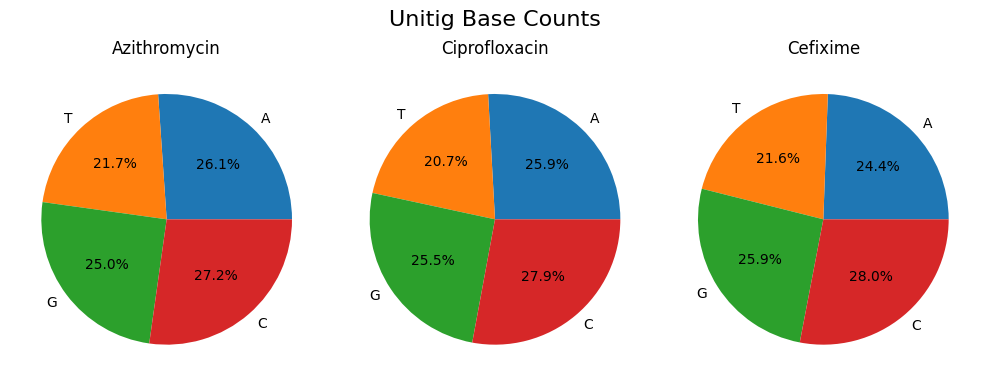

In [47]:
# Plot base counts

n_rows = 1
n_cols = 3
fig, ax = subplots(nrows=n_rows, ncols=n_cols, figsize=(10,4))

ax[0].pie(base_counts_azm, labels=bases, autopct='%1.1f%%')
# ax[0].axis('equal')
ax[0].set_title('Azithromycin')

ax[1].pie(base_counts_cip, labels=bases, autopct='%1.1f%%')
# ax[1].axis('equal')
ax[1].set_title('Ciprofloxacin')

ax[2].pie(base_counts_cfx, labels=bases, autopct='%1.1f%%')
# ax[2].axis('equal')
ax[2].set_title('Cefixime')

fig.suptitle('Unitig Base Counts', fontsize=16)
fig.tight_layout()

<div class="alert alert-block alert-info">
Unitig base counts are balanced. GC content > 50% which is characteristic of <em>Neisseria</em>.<br>
It might be interesting to investigate unitig nucleotide counts by phenotype (S/R) although it is unlikely to be revelatory as unitigs are only 'snippets' of genes and not reflective of gene function.

In [48]:
# Attempted for-loop for base counting for each antibiotic

# antibiotic_unitigs = [unitigs_azm, unitigs_cfx, unitigs_cip]
# tbc_name = ['tbc_azm', 'tbc_cfx', 'tbc_cip']  # tbc = total_base_counts 

# for data_set in antibiotic_unitigs:
    # for name in tbc_name:
        # print(name)
        # name = Counter()
        # name.clear()
        # for seq in data_set:
            # seq_base_counts = Counter(seq.upper())  # Count bases in sequence ensuring case insensitivity
            # name.update(seq_base_counts)  # Update total_base_counts with seq_base_counts
    # print(name)

### As a first attempt, will proceed with Azithromycin dataset for classification.

# Modelling - Random Forest, XGBoost & SVM

In [49]:
# Create dictionary of supervised classifiers

RS = 962  # Random state

classifiers = {'SVM (lin)': LinearSVC(random_state=RS),
               'SVM (rbf)': SVC(kernel='rbf', random_state=RS),
               'Random Forest': RandomForestClassifier(random_state=RS, n_jobs=-1),
               'XGBoost': XGBClassifier(random_state=RS, n_jobs=-1)}

# classifiers = {'SVM (lin)': SVC(kernel='linear', random_state=RS),
            #    'SVM (rbf)': SVC(kernel='rbf', random_state=RS),
            #    'Random Forest': RandomForestClassifier(random_state=RS, n_jobs=-1),
            #    'XGBoost': XGBClassifier(random_state=RS, n_jobs=-1)}

In [50]:
# Cross Validation (Stratified Shuffle Split)

n_splits = 10
train_size = 0.8
sss = StratifiedShuffleSplit(n_splits=n_splits, train_size=train_size, random_state=RS)

In [51]:
# Evaluate classifiers with Stratified Shuffle Split cross validation

# Got a FutureWarning about indexing, so...
# import warnings
# warnings.simplefilter(action='ignore', category=FutureWarning)

accuracy_clf = []  # List for classifiers' accuracy scores
bal_accuracy_clf = []  # List for classifiers' balanced accuracy scores
recall_clf = []  # List for classifiers' recall scores
precision_clf = []  # List for classifiers' precision scores
f1_clf = [] # List of classifiers' f1 scores
times_clf = []  # List for classifiers' compute times

for train_ind, test_ind in sss.split(X_azm, y_azm):  # .split() returns indices for the train and test sample splits
    start_time = process_time()  # Start track task time

    X_train = X_azm[train_ind]  # train_ind = indices of rows used for training
    X_test = X_azm[test_ind]  # test_ind = indices of rows used for testing
    y_train = y_azm.iloc[train_ind]
    y_test = y_azm.iloc[test_ind]

    accuracy_splits = []  # List of split accuracy scores for each classifier
    bal_accuracy_splits = []  # List of split balanced accuracy scores for each classifier
    recall_splits = []  # List of split recall scores for each classifier
    precision_splits = []  # List of split precision scores for each classifier
    f1_splits = []  # List of split f1 scores for each classifier
    times_splits = []  # List of split times for each classifier

    # Train classifier & predict
    for name, clf in classifiers.items():
        clf.fit(X_train, y_train)
        y_pred = clf.predict(X_test)

        # Calculate metrics
        accuracy_splits.append(accuracy_score(y_test, y_pred))  # Calculate the accuracy score for each classifier for each y_test & y_pred split, and append to list
        bal_accuracy_splits.append(balanced_accuracy_score(y_test, y_pred)) # Calculate the balanced accuracy score for each classifier for each y_test & y_pred split, and append to list
        recall_splits.append(recall_score(y_test, y_pred))  # Calculate the recall score for each classifier for each y_test & y_pred split, and append to list
        precision_splits.append(precision_score(y_test, y_pred))  # Calculate the precision score for each classifier for each y_test & y_pred split, and append to list
        f1_splits.append(f1_score(y_test, y_pred))
        end_time = process_time()  # End track task time
        times_splits.append(end_time - start_time)  # Calculate compute time and append to list
        
    accuracy_clf.append(accuracy_splits)  # Append all classifiers' accuracy scores for the same y_test & y_pred splits
    bal_accuracy_clf.append(bal_accuracy_splits)  # Append all classifiers' balanced accuracy scores for the same y_test & y_pred splits
    recall_clf.append(recall_splits)  # Append all classifiers' recall scores for the same y_test & y_pred splits
    precision_clf.append(precision_splits)  # Append all classifiers' precision scores for the same y_test & y_pred splits
    f1_clf.append(f1_splits)  # Append all classifiers' f1 scores for the same y_test & y_pred splits
    times_clf.append(times_splits)

accuracy_mean = round(mean(accuracy_clf, axis=0) * 100, 1)  # axis=0: calculate mean accuracy scores of columns/classifier
bal_accuracy_mean = round(mean(bal_accuracy_clf, axis=0) * 100, 1)  # axis=0: calculate mean balanced accuracy scores of columns/classifier
recall_mean = round(mean(recall_clf, axis=0) * 100, 1)  # axis=0: calculate mean recall scores of columns/classifier
precision_mean = round(mean(precision_clf, axis=0) * 100, 1)  # axis=0: calculate mean precision scores of columns/classifier
f1_mean = round(mean(f1_clf, axis=0) * 100, 1)
times_mean = round(mean(times_clf, axis=0), 2)  # axis=0: calculate mean compute times of columns/classifier


In [52]:
# Sneak peek at metrics

print(accuracy_mean)
print(bal_accuracy_mean)
print(recall_mean)
print(precision_mean)
print(f1_mean)
print(times_mean)

[96.6 97.2 96.7 97.4]
[92.2 95.8 90.7 93.7]
[86.3 93.8 82.7 88.7]
[87.6 85.7 90.6 90.7]
[86.8 89.6 86.3 89.6]
[0.08 0.33 0.59 1.45]


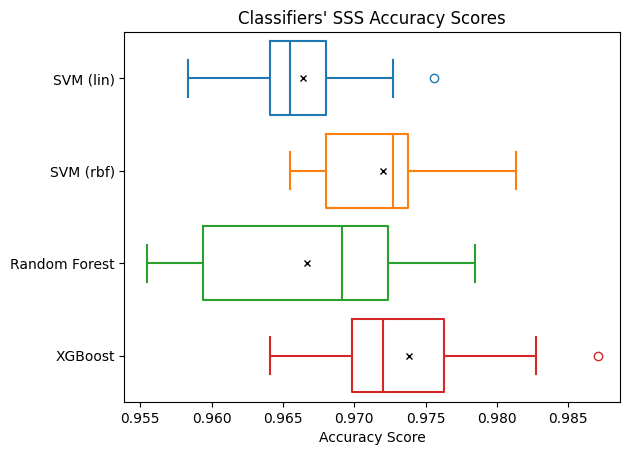

In [53]:
# Boxplot (Seaborne) of classifiers' accuracy scores resulting from Stratified Shuffle Split

# Convert list to Pandas Dataframe for Seaborne
acc_scores_clf_df = DataFrame(accuracy_clf, columns=[name for name in classifiers.keys()])

fig, ax = subplots()

boxplot(data=acc_scores_clf_df, orient='h', fill=False, showmeans=True, meanprops={'marker':'x',
                                                                                'markeredgecolor':'k',
                                                                                'markersize':'5'})
ax.set_title("Classifiers' SSS Accuracy Scores")
ax.set_xlabel('Accuracy Score')

show()

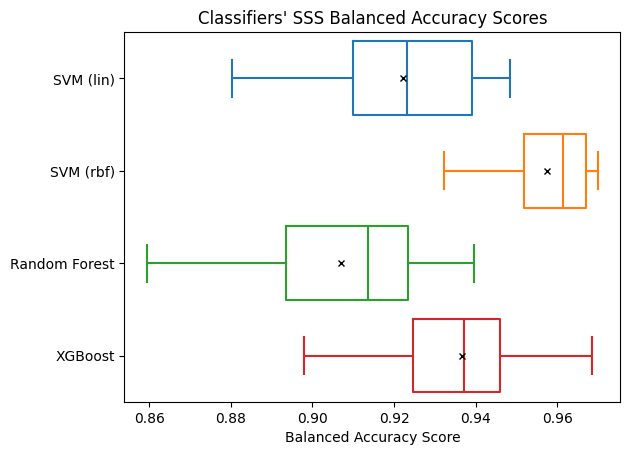

In [54]:
# Boxplot (Seaborne) of classifiers' balanced accuracy scores resulting from Stratified Shuffle Split

# Convert list to Pandas Dataframe for Seaborne
bal_acc_scores_clf_df = DataFrame(bal_accuracy_clf, columns=[name for name in classifiers.keys()])

fig, ax = subplots()

boxplot(data=bal_acc_scores_clf_df, orient='h', fill=False, showmeans=True, meanprops={'marker':'x',
                                                                                'markeredgecolor':'k',
                                                                                'markersize':'5'})
ax.set_title("Classifiers' SSS Balanced Accuracy Scores")
ax.set_xlabel('Balanced Accuracy Score')

show()

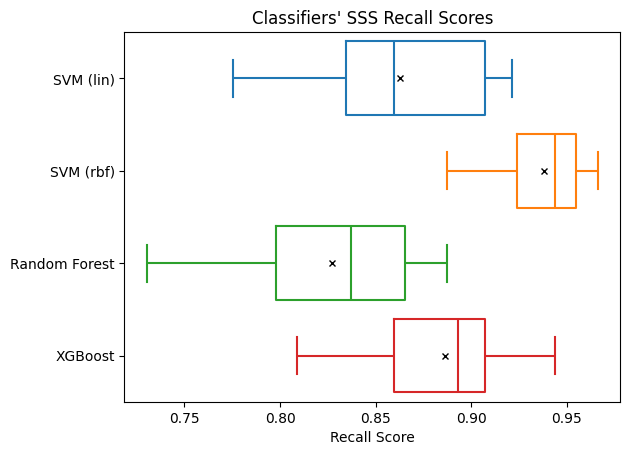

In [55]:
# Boxplot (Seaborne) of classifiers' recall scores resulting from Stratified Shuffle Split

# Convert list to Pandas Dataframe for Seaborne
recall_clf_df = DataFrame(recall_clf, columns=[name for name in classifiers.keys()])

fig, ax = subplots()

boxplot(data=recall_clf_df, orient='h', fill=False, showmeans=True, meanprops={'marker':'x',
                                                                                'markeredgecolor':'k',
                                                                                'markersize':'5'})
ax.set_title("Classifiers' SSS Recall Scores")
ax.set_xlabel('Recall Score')

show()

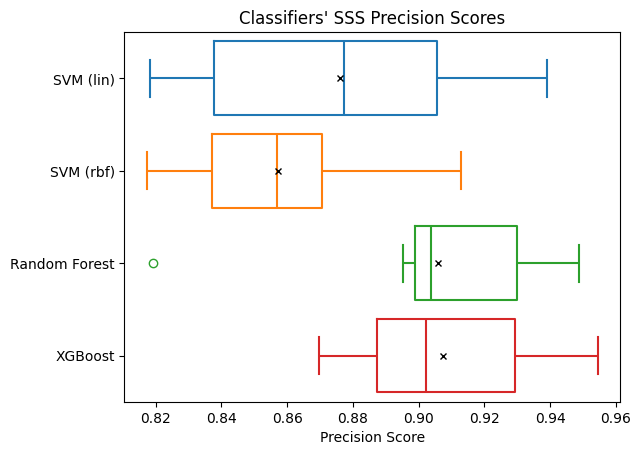

In [56]:
# Boxplot (Seaborne) of classifiers' precision scores resulting from Stratified Shuffle Split

# Convert list to Pandas Dataframe for Seaborne
precision_clf_df = DataFrame(precision_clf, columns=[name for name in classifiers.keys()])

fig, ax = subplots()

boxplot(data=precision_clf_df, orient='h', fill=False, showmeans=True, meanprops={'marker':'x',
                                                                                'markeredgecolor':'k',
                                                                                'markersize':'5'})
ax.set_title("Classifiers' SSS Precision Scores")
ax.set_xlabel('Precision Score')

show()

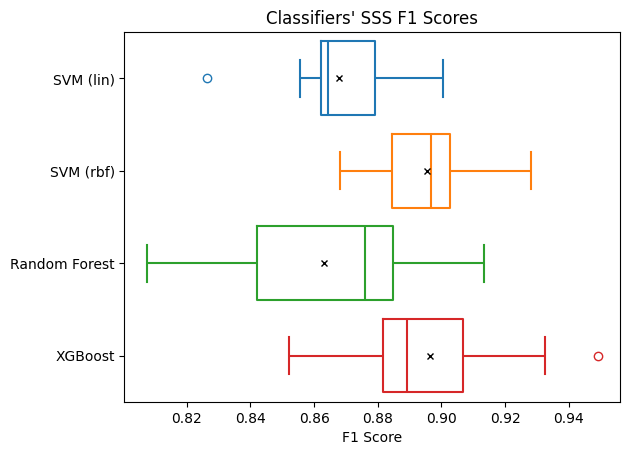

In [57]:
# Boxplot (Seaborne) of classifiers' f1 scores resulting from Stratified Shuffle Split

# Convert list to Pandas Dataframe for Seaborne
f1_clf_df = DataFrame(f1_clf, columns=[name for name in classifiers.keys()])

fig, ax = subplots()

boxplot(data=f1_clf_df, orient='h', fill=False, showmeans=True, meanprops={'marker':'x',
                                                                                'markeredgecolor':'k',
                                                                                'markersize':'5'})
ax.set_title("Classifiers' SSS F1 Scores")
ax.set_xlabel('F1 Score')

show()

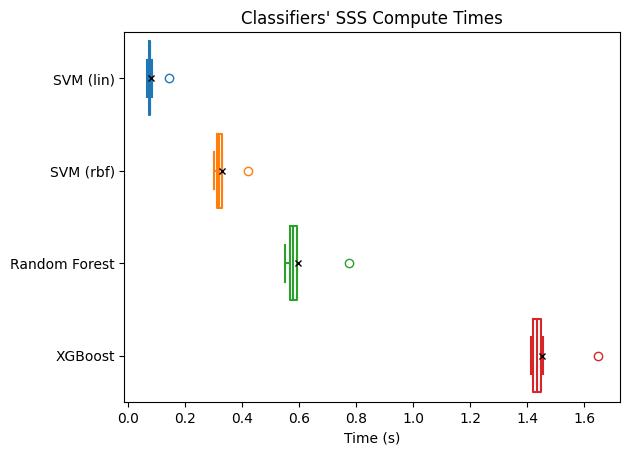

In [58]:
# Boxplot (Seaborne) of classifiers' compute times

# Convert list to Pandas Dataframe for Seaborne
times_clf_df = DataFrame(times_clf, columns=[name for name in classifiers.keys()])

fig, ax = subplots()

boxplot(data=times_clf_df, orient='h', fill=False, showmeans=True, meanprops={'marker':'x',
                                                                                'markeredgecolor':'k',
                                                                                'markersize':'5'})
ax.set_title("Classifiers' SSS Compute Times")
ax.set_xlabel('Time (s)')

show()

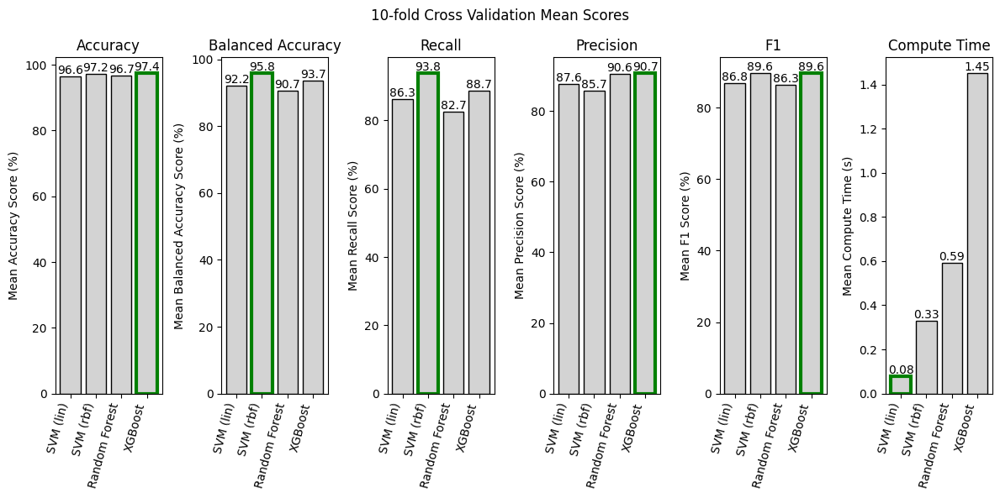

In [59]:
# PLot classifiers' mean scores resulting from Stratified Shuffle Split

plt_labels = list(classifiers.keys())  # Create a list of classifier names from the dictionary keys to be used as plot labels
xticks = arange(len(classifiers.keys()))  # Specify the number of x-ticks

# accuracy_colour = ['r' if (bar == max(accuracy_mean)) else 'b' for bar in accuracy_mean]  # Colour the highest mean accuracy score red
# bal_accuracy_colour = ['r' if (bar == max(bal_accuracy_mean)) else 'b' for bar in bal_accuracy_mean]  # Colour the highest mean balanced accuracy score red
# recall_colour = ['r' if (bar == max(recall_mean)) else 'b' for bar in recall_mean]  # Colour the highest mean recall score red
# precision_colour = ['r' if (bar == max(precision_mean)) else 'b' for bar in precision_mean]  # Colour the highest mean precision score red
# times_colour = ['r' if (bar == min(times_mean)) else 'b' for bar in times_mean]  # Colour the lowest mean compute time red

accuracy_edgecolour = ['g' if (bar == max(accuracy_mean)) else 'k' for bar in accuracy_mean]  # Set line colour of the highest mean accuracy score to green
bal_accuracy_edgecolour = ['g' if (bar == max(bal_accuracy_mean)) else 'k' for bar in bal_accuracy_mean]  # Set line colour of the highest mean balanced accuracy score to green
recall_edgecolour = ['g' if (bar == max(recall_mean)) else 'k' for bar in recall_mean]  # Set line colour of the highest mean recall score to green
precision_edgecolour = ['g' if (bar == max(precision_mean)) else 'k' for bar in precision_mean]  # Set line colour of the highest mean precision score to green
f1_edgecolour = ['g' if (bar == max(f1_mean)) else 'k' for bar in f1_mean]  # Set line colour of the highest mean f1 score to green
times_edgecolour = ['g' if (bar == min(times_mean)) else 'k' for bar in times_mean]  # Set line colour of the lowest mean compute time to green

accuracy_linewidth = [3 if (bar == max(accuracy_mean)) else 1 for bar in accuracy_mean]  # Thicken line width of the highest mean accuracy score
bal_accuracy_linewidth = [3 if (bar == max(bal_accuracy_mean)) else 1 for bar in bal_accuracy_mean]  # Thicken line width of the highest mean balanced accuracy score
recall_linewidth = [3 if (bar == max(recall_mean)) else 1 for bar in recall_mean]  # Thicken line width of the highest mean recall score
precision_linewidth = [3 if (bar == max(precision_mean)) else 1 for bar in precision_mean]  # Thicken line width of the highest mean precision score
f1_linewidth = [3 if (bar == max(f1_mean)) else 1 for bar in f1_mean]  # Thicken line width of the highest mean precision score
times_linewidth = [3 if (bar == min(times_mean)) else 1 for bar in times_mean]  # Thicken line width of the lowhest mean compute time

n_cols = 6  # Number of metrics
fig, ax = subplots(ncols=n_cols, figsize=(12,6))

accuracy_bar_con = ax[0].bar(x=xticks, height=accuracy_mean, tick_label=plt_labels, color='lightgray', edgecolor=accuracy_edgecolour, linewidth=accuracy_linewidth)  # Create a bar container to label the bars with the scores
ax[0].bar_label(accuracy_bar_con)  # .bar_label() uses the the data values (i.e., height=) from the container (bar_con) as labels
ax[0].set_ylabel('Mean Accuracy Score (%)')
ax[0].set_xticklabels(plt_labels, rotation=75, ha='right')
ax[0].set_title("Accuracy")

bal_accuracy_bar_con = ax[1].bar(x=xticks, height=bal_accuracy_mean, tick_label=plt_labels, color='lightgray', edgecolor=bal_accuracy_edgecolour, linewidth=bal_accuracy_linewidth)  # Create a bar container to label the bars with the scores
ax[1].bar_label(bal_accuracy_bar_con)  # .bar_label() uses the the data values (i.e., height=) from the container (bar_con) as labels
ax[1].set_ylabel('Mean Balanced Accuracy Score (%)')
ax[1].set_xticklabels(plt_labels, rotation=75, ha='right')
ax[1].set_title("Balanced Accuracy")

recall_bar_con = ax[2].bar(x=xticks, height=recall_mean, tick_label=plt_labels, color='lightgray', edgecolor=recall_edgecolour, linewidth=recall_linewidth)  # Create a bar container to label the bars with the scores
ax[2].bar_label(recall_bar_con)  # .bar_label() uses the the data values (i.e., height=) from the container (bar_con) as labels
ax[2].set_ylabel('Mean Recall Score (%)')
ax[2].set_xticklabels(plt_labels, rotation=75, ha='right')
ax[2].set_title("Recall")

precision_bar_con = ax[3].bar(x=xticks, height=precision_mean, tick_label=plt_labels, color='lightgray', edgecolor=precision_edgecolour, linewidth=precision_linewidth)  # Create a bar container to label the bars with the scores
ax[3].bar_label(precision_bar_con)  # .bar_label() uses the the data values (i.e., height=) from the container (bar_con) as labels
ax[3].set_ylabel('Mean Precision Score (%)')
ax[3].set_xticklabels(plt_labels, rotation=75, ha='right')
ax[3].set_title("Precision")

f1_bar_con = ax[4].bar(x=xticks, height=f1_mean, tick_label=plt_labels, color='lightgray', edgecolor=precision_edgecolour, linewidth=precision_linewidth)  # Create a bar container to label the bars with the scores
ax[4].bar_label(f1_bar_con)  # .bar_label() uses the the data values (i.e., height=) from the container (bar_con) as labels
ax[4].set_ylabel('Mean F1 Score (%)')
ax[4].set_xticklabels(plt_labels, rotation=75, ha='right')
ax[4].set_title("F1")

time_bar_con = ax[5].bar(x=xticks, height=times_mean, tick_label=plt_labels, color='lightgray', edgecolor=times_edgecolour, linewidth=times_linewidth)  # Create a bar container to label the bars with the scores
ax[5].bar_label(time_bar_con)  # .bar_label() uses the the data values (i.e., height=) from the container (bar_con) as labels
ax[5].set_ylabel('Mean Compute Time (s)')
ax[5].set_xticklabels(plt_labels, rotation=75, ha='right')
ax[5].set_title("Compute Time")

fig.suptitle(f"{n_splits}-fold Cross Validation Mean Scores")
fig.tight_layout()

show()

<div class="alert alert-block alert-info">
All models perform well with Accuracy scores >90%, particularly SVM(rbf) & XGBoost. The 'Balanced Accuracy' and 'F1' can be important for evaluating the model performance when dealing with imbalanced classes (<em>e.g.</em>, for azm & cfx).
The F1 score is the 'harmonic' mean of the Recall and Precision scores.<br>
There is a ~20x range in computation time, and ~4x diffrence between SVM(rbf) and XGBoost which for this small dataset is negligible.

# Confusion matrix evaluation

In [60]:
# Split training and test data

train_size = 0.8
X_train, X_test, y_train, y_test = train_test_split(X_azm, y_azm, train_size=train_size, random_state=RS, shuffle=True)

print(X_azm.shape, X_train.shape, X_test.shape, y_azm.shape, y_train.shape, y_test.shape)

(3478, 515) (2782, 515) (696, 515) (3478,) (2782,) (696,)


In [61]:
def plot_confusion_matrix(y_true, y_pred, classes, normalize=True, ax=None):
    """
    This function prints/plots the confusion matrix (adapted from a SciKit-Learn example)

    y_true: Actual class labels (array)
    y_pred: Predicted class labels (array)
    classes: Class names (str, array)
    normalize: Normalize the results (True), or show as integer values (False)
    ax: Visualization axis
    """

    from itertools import product
    from numpy import asarray, newaxis
    from sklearn.metrics import confusion_matrix

    cm = confusion_matrix(y_true, y_pred)
    n_classes = len(classes)

    if normalize:
        cm = asarray(cm).astype('float32') /cm.sum(axis=1)[:, newaxis]

    if not ax:
        from matplotlib.pyplot import subplots
        _, ax = subplots()

    ticks = range(n_classes)
    ax.imshow(cm, interpolation='nearest', cmap='Blues')
    ax.set_xticks(ticks)
    ax.set_xticklabels(classes, rotation=90)
    ax.set_yticks(ticks)
    ax.set_yticklabels(classes)
    fmt = '.2f' if normalize else 'd'
    thresh = 3*cm.max() / 4
    cm_dim = cm.shape

    # Matrix indices:
    indices_a = range(cm_dim[0])
    indices_b = range(cm_dim[1])
    # Cartesian product of matrix indices:
    indices = product(indices_a, indices_b)
    fmt = '.3f' if normalize else 'd'

    for ind_a, ind_b in indices:
      label = format(cm[ind_a, ind_b], fmt)
      color = "white" if cm[ind_a, ind_b] > thresh else "black"
      ax.text(ind_b, ind_a, label, ha="center", color=color)
    ax.set_ylabel('True Labels')
    ax.set_xlabel('Predicted Labels')

    return ax

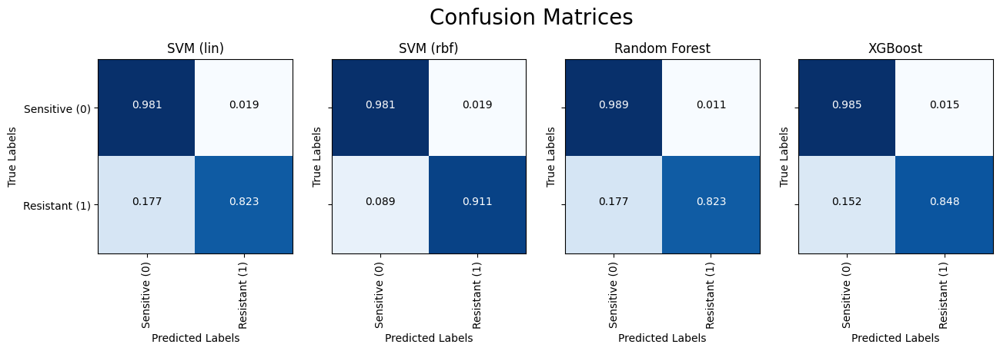

In [62]:
# Confusion matrix evaluation

class_names = ('Sensitive (0)', 'Resistant (1)')

n_cols = len(classifiers)
fig, axes = subplots(figsize=(15, 4), ncols=n_cols, sharey=True, sharex=True)

for ax, (name, clf) in zip(axes.ravel(), classifiers.items()):
    clf.fit(X_train, y_train)  # Fit with training data
    y_pred = clf.predict(X_test)  # Predict class labels using test data

    plot_confusion_matrix(y_test, y_pred, classes=class_names, normalize=True, ax=ax)
    ax.set_title(name, fontsize=12)

fig.suptitle('Confusion Matrices', fontsize=20)
show()

<div class="alert alert-block alert-info">
The relatively low but significant false negative rate is concerning for AMR prediction. Larger datasets may help.

# AUROC evaluation

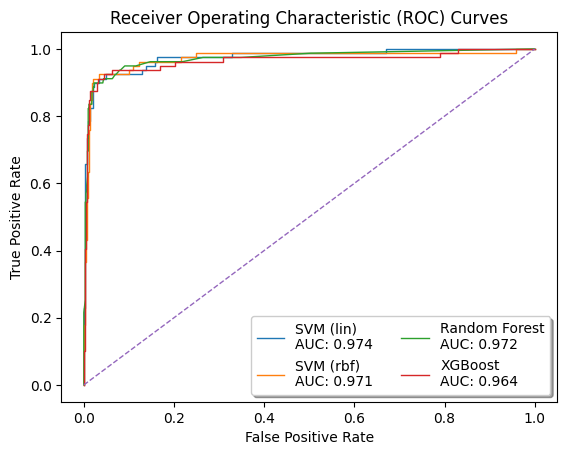

In [63]:
# AUROC - a more comoprehensive picture of TPR v FPR (considering all thresholds of Confusion Matrix)

fig, ax = subplots()

for name, clf in classifiers.items():
    clf.fit(X_train, y_train)

    # Checking whether or not the object has 'decision_function':
    if hasattr(clf, 'decision_function'):  # If it does...
        y_score = clf.decision_function(X_test)
    else:
        y_score = clf.predict_proba(X_test)[:, 1]  # We only need probabilities for one column.

    # Obtaining the x- and y-axis values for the ROC curve:
    fpr, tpr, thresh = roc_curve(y_test, y_score)

    # Obtaining the AUC value:
    roc_auc = roc_auc_score(y_test, y_score)

    ax.plot(fpr, tpr, lw=1, label = f'{name}\nAUC: {round(roc_auc, 3)}')

x1, x2 = 0, 1
y1, y2 = 0, 1
ax.plot([x1, x2], [y1, y2], lw=1, linestyle='--') 
ax.set_title('Receiver Operating Characteristic (ROC) Curves', fontsize=12)
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.legend(ncols=2, fontsize=10, shadow=True)

show()

<div class="alert alert-block alert-info">
All model performances are high and comparable.

# Feature Importance

In [64]:
# For SVM with non-linear kernels (e.g., RBF) the .coef_ attribute is not applicable because the data is transformed into a higher-dimensional space.
# In such cases, permutation_importance() can be used to estimate feature importance.

# Instantiate classification estimator objects

svm_clf = LinearSVC(random_state=RS)

rf_clf = RandomForestClassifier(random_state=RS)

xgb_clf = XGBClassifier(n_estimators=100, learning_rate=0.01, random_state=RS)

In [65]:
# Train models

svm_clf.fit(X_train, y_train)

rf_clf.fit(X_train, y_train)

xgb_clf.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              feature_weights=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.01, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=100,
              n_jobs=None, num_parallel_tree=None, ...)

In [66]:
# Extract feature importances

importances_svm = svm_clf.coef_  # Only for SVM linear

importances_rf = rf_clf.feature_importances_

importances_xgb = xgb_clf.feature_importances_

In [67]:
# Inspect feature importances

print(importances_svm)

print(importances_rf)

importances_xgb

# NB: feature importances are not sorted

[[-5.78299897e-04  0.00000000e+00 -1.02965377e+00  0.00000000e+00
  -4.70085505e-05 -5.28613589e-06 -4.01804897e-06 -3.32089520e-06
  -4.32662641e-06 -5.76434165e-06 -1.98415427e-06 -7.88859075e-06
  -2.34077075e-04 -1.84589673e-04  2.13964838e-05 -2.05328950e-04
   4.07019001e-03  1.10387970e-03  7.97202781e-03  2.04182931e-04
   1.23379251e+00 -1.08347676e-05 -6.66818828e-06 -4.83690039e-04
  -8.34544564e-01 -6.17277088e-05  5.01652848e-01 -3.32013889e-05
   1.32354735e-04 -9.96101521e-05  0.00000000e+00  6.80101267e-04
  -7.46648939e-04 -2.69153070e-06 -1.07687040e-05 -3.33104478e-06
  -3.58010643e-05 -3.13764867e-06 -1.96268556e-05 -2.99979885e-02
  -7.37029788e-05 -2.18672451e-04 -1.60570732e-01 -6.75539143e-06
  -1.81659267e-06  0.00000000e+00 -6.15139624e-06 -6.00230010e-05
   8.13357005e-05 -1.00760204e-05 -2.28353319e-06 -2.78104987e-05
  -2.41352108e-05  0.00000000e+00 -2.31381456e-05 -1.59192776e-01
   7.68687099e-05 -4.97885970e-05  0.00000000e+00  3.24988848e-05
  -1.06766

array([0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e

## SVM feature (unitig) importance

In [68]:
# Display unitig importances in Dataframe

importance_svm_df = DataFrame({'Unitigs': unitigs_azm, 'Importance': importances_svm.ravel()})
importance_svm_df

,Unitigs,Importance
0,CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG,-0.000578
1,TACCGTAACCGGCAATGCGGATATTACGGTC,0.000000
2,CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG,-1.029654
3,AACGGGTTTTCAGACGGCATTCGATATCGGGACG,0.000000
4,CCAAAAATTACCCGCGTTGACGTAGCTAAAGA,-0.000047
...,...,...
510,ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG,-0.084651
511,ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGC...,-0.085351
512,ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC,-0.084660
513,AGCCTGATTCACCAATGGTTTGTTCATAACAA,-0.084524


In [69]:
# Focus on the top 5 negative unitig importances

top5_svm_neg_imp_df = importance_svm_df.sort_values(by='Importance').head()
top5_svm_neg_imp_df

,Unitigs,Importance
316,TCATCTCGTATGCCGTCTTCTGCTTGAAAAA,-2.115333
178,CCGGCTCAAAGGGAACGGTTTCCTAAGGTGC,-1.525435
497,TCGGCGTAATCGGCGGCAATGCGCCGCACCCGCC,-1.359416
2,CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG,-1.029654
156,AATATTCCGTGAACATAAAAGAGTTGAAAAA,-1.021698


In [70]:
# Extract top 5 negative unitigs

top5_svm_neg_unitigs = top5_svm_neg_imp_df['Unitigs'].to_list()
top5_svm_neg_unitigs

['TCATCTCGTATGCCGTCTTCTGCTTGAAAAA',
 'CCGGCTCAAAGGGAACGGTTTCCTAAGGTGC',
 'TCGGCGTAATCGGCGGCAATGCGCCGCACCCGCC',
 'CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG',
 'AATATTCCGTGAACATAAAAGAGTTGAAAAA']

In [71]:
# Extract top 5 negative importances

top5_svm_neg_importances = top5_svm_neg_imp_df['Importance'].to_list()
top5_svm_neg_importances

[-2.1153331666220727,
 -1.5254353565138312,
 -1.3594161262050641,
 -1.0296537731701625,
 -1.0216983157627255]

In [72]:
# Focus on the top 5 positive unitig importances

top5_svm_pos_imp_df = importance_svm_df.sort_values(by='Importance').tail()
top5_svm_pos_imp_df

,Unitigs,Importance
20,ATAAAGATGAGATAACGGCTTTGATTAATAGTCTTAAATAAAGGGGC,1.233793
507,CGTTCCTTTCGGCGTATTCTCGCCGTTGCGCGGCG,1.251113
464,GGTCAGTTCGAAAAGGATGGTATTTTGTTGACCGCCG,1.520047
127,CAATCTACCCGCTGCTAGACGGAAAGACCCCGTGAAC,1.599953
150,GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGC...,2.324838


In [73]:
# Extract top 5 positive unitigs

top5_svm_pos_unitigs = top5_svm_pos_imp_df['Unitigs'].to_list()
top5_svm_pos_unitigs

['ATAAAGATGAGATAACGGCTTTGATTAATAGTCTTAAATAAAGGGGC',
 'CGTTCCTTTCGGCGTATTCTCGCCGTTGCGCGGCG',
 'GGTCAGTTCGAAAAGGATGGTATTTTGTTGACCGCCG',
 'CAATCTACCCGCTGCTAGACGGAAAGACCCCGTGAAC',
 'GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGCGTTGGAAGTTTGACG']

In [74]:
# Extract top 5 postive importances

top5_svm_pos_importances = top5_svm_pos_imp_df['Importance'].to_list()
top5_svm_pos_importances

[1.2337925083047356,
 1.251113488771261,
 1.5200466815912606,
 1.599952516531383,
 2.3248381593679874]

In [75]:
# Combine SVM negative & positive unitig importances

top10_svm_unitigs = top5_svm_neg_unitigs + top5_svm_pos_unitigs
top10_svm_unitigs, len(top10_svm_unitigs)

(['TCATCTCGTATGCCGTCTTCTGCTTGAAAAA',
  'CCGGCTCAAAGGGAACGGTTTCCTAAGGTGC',
  'TCGGCGTAATCGGCGGCAATGCGCCGCACCCGCC',
  'CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG',
  'AATATTCCGTGAACATAAAAGAGTTGAAAAA',
  'ATAAAGATGAGATAACGGCTTTGATTAATAGTCTTAAATAAAGGGGC',
  'CGTTCCTTTCGGCGTATTCTCGCCGTTGCGCGGCG',
  'GGTCAGTTCGAAAAGGATGGTATTTTGTTGACCGCCG',
  'CAATCTACCCGCTGCTAGACGGAAAGACCCCGTGAAC',
  'GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGCGTTGGAAGTTTGACG'],
 10)

In [76]:
top10_svm_importances = top5_svm_neg_importances + top5_svm_pos_importances
top10_svm_importances, len(top10_svm_importances)

([-2.1153331666220727,
  -1.5254353565138312,
  -1.3594161262050641,
  -1.0296537731701625,
  -1.0216983157627255,
  1.2337925083047356,
  1.251113488771261,
  1.5200466815912606,
  1.599952516531383,
  2.3248381593679874],
 10)

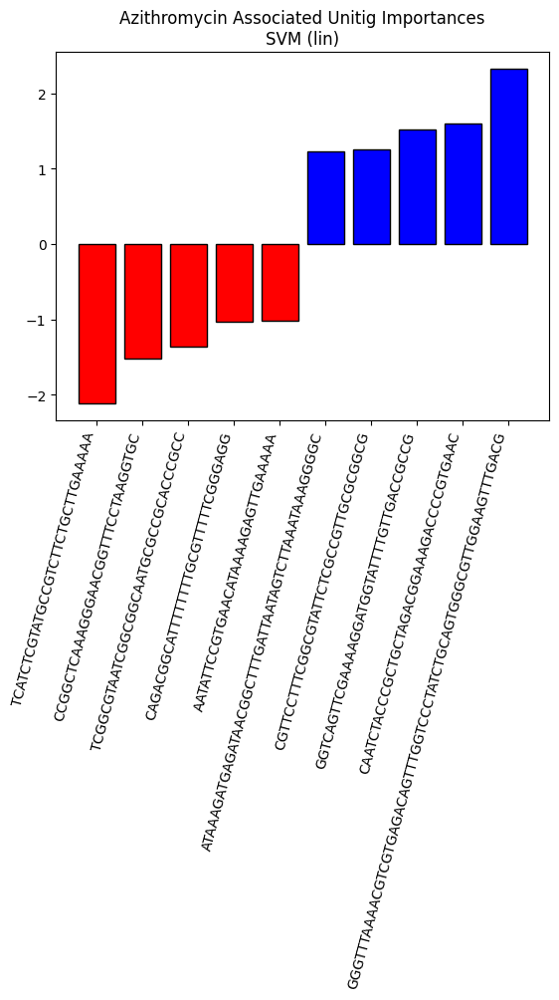

In [77]:
# Plot SVM top 10 unitig importances

fig, ax = subplots()

svm_colour = ['r' if (value < 0) else 'b' for value in top10_svm_importances]
edge_colour = 'k'
ax.bar(x=top10_svm_unitigs, height=top10_svm_importances, color=svm_colour, edgecolor=edge_colour)
ax.set_title('Azithromycin Associated Unitig Importances\nSVM (lin)')
ax.set_xticks(top10_svm_unitigs)
ax.set_xticklabels(labels=top10_svm_unitigs, rotation=75, ha='right')

show()

## Random Forest feature (unitig) importance

In [78]:
# Display unitig importances in Dataframe

importance_rf_df = DataFrame({'Unitigs': unitigs_azm, 'Importance': importances_rf})
importance_rf_df

,Unitigs,Importance
0,CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG,1.125694e-05
1,TACCGTAACCGGCAATGCGGATATTACGGTC,0.000000e+00
2,CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG,1.440029e-03
3,AACGGGTTTTCAGACGGCATTCGATATCGGGACG,0.000000e+00
4,CCAAAAATTACCCGCGTTGACGTAGCTAAAGA,6.680788e-07
...,...,...
510,ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG,0.000000e+00
511,ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGC...,0.000000e+00
512,ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC,0.000000e+00
513,AGCCTGATTCACCAATGGTTTGTTCATAACAA,1.212395e-04


In [79]:
# Focus on top 5 unitig importances

top5_rf_imp_df = importance_rf_df.sort_values(by='Importance', ascending=False)[:5]
top5_rf_imp_df

,Unitigs,Importance
150,GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGC...,0.230985
173,AAAGGCGTTTGCGTTGCGAGGAGTTCATATC,0.045357
316,TCATCTCGTATGCCGTCTTCTGCTTGAAAAA,0.043300
345,CATCTGCCTGGCAAACGCTTCCCCGTCGCCCTCGAA,0.038259
319,ACCGTAACCGGCAATGCGGATATTACGGTCA,0.030310


In [80]:
# Extract top 5 unitigs

top5_rf_unitigs = top5_rf_imp_df['Unitigs'].to_list()
top5_rf_unitigs

['GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGCGTTGGAAGTTTGACG',
 'AAAGGCGTTTGCGTTGCGAGGAGTTCATATC',
 'TCATCTCGTATGCCGTCTTCTGCTTGAAAAA',
 'CATCTGCCTGGCAAACGCTTCCCCGTCGCCCTCGAA',
 'ACCGTAACCGGCAATGCGGATATTACGGTCA']

In [81]:
# Extract top 5 importances

top5_rf_importances = top5_rf_imp_df['Importance'].to_list()
top5_rf_importances

[0.2309846185221053,
 0.04535718711383499,
 0.04329972472986083,
 0.03825851630197516,
 0.030309994418322776]

## XGBoost feature (unitig) importance

In [82]:
# Display unitig importances in Dataframe

importance_xgb_df = DataFrame({'Unitigs': unitigs_azm, 'Importance': importances_xgb})
importance_xgb_df

,Unitigs,Importance
0,CTTAACATATTTGCCTTTGATTTTTGAAGAAGCTGCCACGCCGGCAG,0.0
1,TACCGTAACCGGCAATGCGGATATTACGGTC,0.0
2,CAGACGGCATTTTTTTTGCGTTTTTCGGGAGG,0.0
3,AACGGGTTTTCAGACGGCATTCGATATCGGGACG,0.0
4,CCAAAAATTACCCGCGTTGACGTAGCTAAAGA,0.0
...,...,...
510,ACGCCGAAAGGAACGTGTATGCTGCCGCCCAACTGCG,0.0
511,ACTCGAATTTTGCAGGATTGGTATCAATGGCGATAATGCGACCGGC...,0.0
512,ACCCGGCCCGGGCTGGCAGGCTACGGCTACACCGGTATCC,0.0
513,AGCCTGATTCACCAATGGTTTGTTCATAACAA,0.0


In [83]:
# Focus on top 5 unitig importances

top5_xgb_imp_df = importance_xgb_df.sort_values(by='Importance', ascending=False)[:5]
top5_xgb_imp_df

,Unitigs,Importance
150,GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGC...,0.596201
316,TCATCTCGTATGCCGTCTTCTGCTTGAAAAA,0.269804
401,AGGGCCTTGACTTGTTCGGGTGTCAGCATAG,0.020596
465,CGGATATAGTGGATTAACAAAAATCAGGACA,0.007601
395,GCGTTCCGCATTGAGCAGTGGTCTGATTTCCCAAGTCTTGTGAAGT...,0.006945


In [84]:
# Extract top 5 unitigs

top5_xgb_unitigs = top5_xgb_imp_df['Unitigs'].to_list()
top5_xgb_unitigs

['GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGCGTTGGAAGTTTGACG',
 'TCATCTCGTATGCCGTCTTCTGCTTGAAAAA',
 'AGGGCCTTGACTTGTTCGGGTGTCAGCATAG',
 'CGGATATAGTGGATTAACAAAAATCAGGACA',
 'GCGTTCCGCATTGAGCAGTGGTCTGATTTCCCAAGTCTTGTGAAGTCTTAACTGCCTTACC']

In [85]:
# Extract top 5 importances

top5_xgb_importances = top5_xgb_imp_df['Importance'].to_list()
top5_xgb_importances

[0.5962009429931641,
 0.2698044180870056,
 0.020595964044332504,
 0.007600716315209866,
 0.006944974418729544]

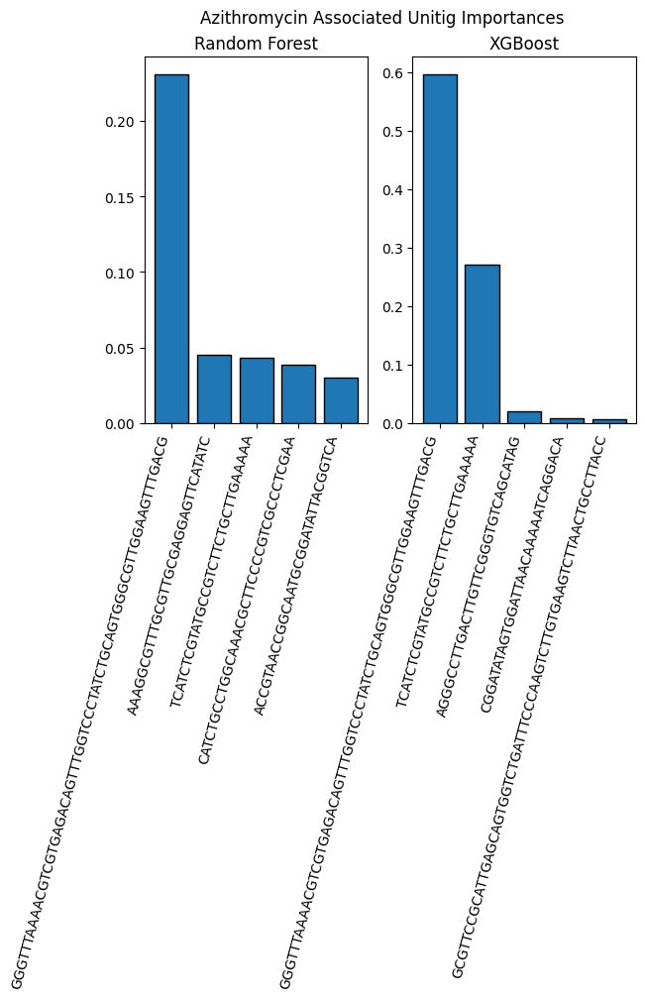

In [86]:
# Plot Random Forest & XGBoost top 5 unitig importances

n_cols = 2
fig, ax = subplots(ncols=n_cols)

edge_colour = 'k'

ax[0].bar(x=top5_rf_unitigs, height=top5_rf_importances, edgecolor=edge_colour)
ax[0].set_title('Random Forest')
ax[0].set_xticks(top5_rf_unitigs)
ax[0].set_xticklabels(labels=top5_rf_unitigs, rotation=75, ha='right')

ax[1].bar(x=top5_xgb_unitigs, height=top5_xgb_importances, edgecolor=edge_colour)
ax[1].set_title('XGBoost')
ax[1].set_xticks(top5_xgb_unitigs)
ax[1].set_xticklabels(labels=top5_xgb_unitigs, rotation=75, ha='right')

fig.suptitle('Azithromycin Associated Unitig Importances')
show()

<div class="alert alert-block alert-info">
It is encouraging that each model identified the same two unitigs as important features in the modelling:<br>
'GGGTTTAAAACGTCGTGAGACAGTTTGGTCCCTATCTGCAGTGGGCGTTGGAAGTTTGACG' and 'TCATCTCGTATGCCGTCTTCTGCTTGAAAAA'.<br>
An NCBI BLAST search was unsuccessful in identifying candidate genes.

# Further studies...

# Hyperparamter Tuning? (if poor scores)

# Unit testing

# Neural network

# Cluster unitigs